In [3]:
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.animation as animation
plt.style.use(['dark_background'])

from util import experiment
from util import preprocess
from util import register
import importlib 
 
import numpy as np
import pandas as pd
import os

from numba import jit, vectorize

import cython
%load_ext cython

In [9]:
importlib.reload(preprocess)
importlib.reload(register)
importlib.reload(experiment)


# exp_name = "081023B"

symphony_file = r"C:\Users\zfj\data\071323B\071323B.h5"#f"C:\\Users\\zfj\\data\\{exp_name}\\{exp_name}.h5"
# symphony_file = f"C:\\Users\\zfj\\data\\{exp_name}\\{exp_name}.h5"
bin_path =f"C:\\Users\\zfj\\data\\071323B\\func"
mask_file = r"C:\Users\zfj\data\071323B\071323B_region2_stack_red_avg_axonsmasked_cp_masks.png"
# mask_file = None
# stack = r"C:\Users\zfj\data\082423B\region1_stack_00002.tif"
stack = r"C:\Users\zfj\data\071323B\region2_stack_00001.tif"
# stack = None

artifact_file = f"C:\\Users\\zfj\\code\\functionalimaginganalysis\\python\\artifact_lut.npy"
dark_file = r"C:\Users\zfj\data\071323B\dark_level_00001.tif"

e = experiment.Experiment(symphony_file, 
    # [os.path.join(f"C:\\Users\\zfj\\data\\{exp_name}\\",i) for i in [
    #     # 'region3_00003.tif',
    #     # 'region3_00003.tif',
    #     # 'region3_00004.tif',        
    #     # 'region2_927nm_00001.tif',
    #     # 'region2_820nm_00001.tif',
    #     # 'region1_00003.tif',
    #     # 'region1_00002.tif',
    #     'region1_927nm_00001.tif',
        
    # ]],
    [
        # r"C:\Users\zfj\data\081023B\region2_820nm_00003.tif",
        r"C:\Users\zfj\data\071323B\region2_820nm_00001.tif",
      ],
  #  bin_path, artifact_file, stack, mask_file, dark_file, fixed_offset=(19, 28))#, planes = [19,22])
   bin_path, artifact_file, stack, mask_file, dark_file, fixed_offset=(0,0)) #, planes=[29,82]) #fixed_offset=(16, 9))#, planes = [19,22])
# def __init__(self, timing_file: str, raw_files: List[str], bin_path: str, artifact_file: str, stack_file: str, mask_file: str, dark_file: str, func_channel = 1, anat_channel=0):


region2_820nm_00001


IndexError: index -1 is out of bounds for axis 0 with size 0

In [69]:
e.events.iloc[26:27]
# e.events.iloc[0]

,pre_on,stim_on,stim_off,tail_off,pre_on_i,stim_on_i,stim_off_i,tail_off_i,epoch_id,start_time,...,spotStimFrames,spotTailFrames,stimTime,stimTimeRecord,tailTime,LED,intensity,end_time,flips,frame_indices
26,310355653,310422839,311228693,311295911,3,15,194,209,89,638272717221587638,...,15.0,45.0,35000.0,0,0.0,50.0,0.125,638272717571587638,"[310355653, 310373626, 310378237, 310382589, 3...","[3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ..."


In [2]:
# raw, props = preprocess.read_raw_file(r"C:\Users\zfj\data\petrilab\2p functional imaging\20230908\20230908Dcc3-power-17mW-chirp_00001.tif", None)
import suite2p
import re
import datetime

tif = suite2p.io.tiff.ScanImageTiffReader(r"D:\Aalto rig\Functional imaging data\20230915\20230915Dcc1_functional_00001_00001.tif")

In [4]:
t = [float(x) for x in re.search("epoch = \[((?:\d+.?\d+,?\s*)+)\]", tif.description(0)).groups()[0].split()]
t.append(t[-1] % 1 * 1e6)
t = [int(ti) for ti in t]
t = datetime.datetime(*t)
# print(tif.description(0))

In [5]:
flps = []
trks = []
for i in range(0, tif.shape()[0],2):

    tmp = re.search('auxTrigger1 = \[((?:-?\d+.?\d+\s?\,?)+)\]', tif.description(i))
    if tmp is not None:
        flps.append([float(x) for x in tmp.groups()[0].split(' ,')])

    tmp = re.search('auxTrigger0 = \[((?:-?\d+.?\d+\s?\,?)+)\]', tif.description(i))
    if tmp is not None:
        trks.append([float(x) for x in tmp.groups()[0].split(' ,')])


def debounce(s, th=1.5e-2):
    d = np.diff(s, append=np.inf) > th
    while not d.all():
        s = s[d]
        # d = np.diff(flps, prepend=-np.inf) > th
        d = np.diff(s, append=np.inf) > th
    return s


flps = debounce(np.concatenate(flps))
trks = debounce(np.concatenate(trks))


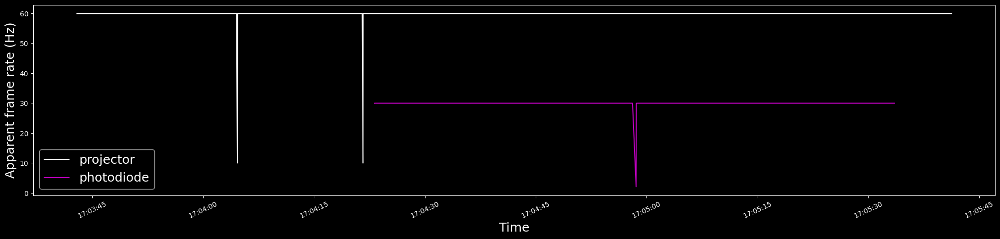

In [6]:
plt.figure(figsize=(25,5))
plt.plot(np.datetime64(t) + (flps[1:] * 1e6).astype('timedelta64[us]'),1/np.diff(flps), c='w', label='projector')
plt.plot(np.datetime64(t) + (trks[1:] * 1e6).astype('timedelta64[us]'),1/np.diff(trks), c='m', label='photodiode')
# plt.plot(datetime.datetime.timestamp(t) + trks[1:],1/np.diff(trks))


plt.xticks(rotation=25)
plt.xlabel('Time', fontsize=18)
plt.ylabel('Apparent frame rate (Hz)', fontsize=18)

plt.legend(fontsize=18)
plt.show()


20230915Dcc1_functional_00001_00001.tif
20230915Dcc1_functional_00001_00002.tif
20230915Dcc1_functional_00001_00003.tif
20230915Dcc1_functional_00001_00004.tif
20230915Dcc1_functional_00001_00005.tif
20230915Dcc1_functional_00002_00001.tif
20230915Dcc1_functional_00002_00002.tif
20230915Dcc1_functional_00002_00003.tif
20230915Dcc1_functional_00002_00004.tif
20230915Dcc1_functional_00002_00005.tif
20230915Dcc1_functional_00002_00006.tif
20230915Dcc1_functional_00002_00007.tif
20230915Dcc1_functional_00002_00008.tif
20230915Dcc1_functional_00002_00009.tif
20230915Dcc1_functional_00002_00010.tif
20230915Dcc1_functional_00002_00011.tif
20230915Dcc1_functional_00002_00012.tif
20230915Dcc1_functional_00002_00013.tif
20230915Dcc1_functional_00002_00014.tif
20230915Dcc1_functional_00002_00015.tif
20230915Dcc1_functional_00002_00016.tif
20230915Dcc1_functional_00002_00017.tif
20230915Dcc1_functional_00002_00018.tif
20230915Dcc1_functional_00002_00019.tif
20230915Dcc1_functional_00002_00020.tif


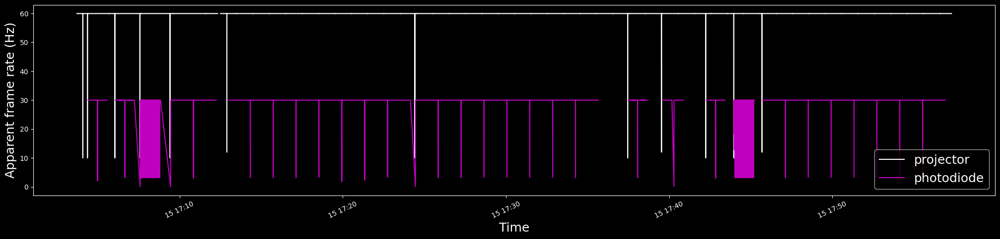

In [7]:

plt.figure(figsize=(25,5))
j = 0
for file in os.listdir(r"D:\Aalto rig\Functional imaging data\20230915"):
    if not (file.startswith(r"20230915Dcc1_functional") and file.endswith(r".tif")):
        continue
    print(file)
    
    tif = suite2p.io.tiff.ScanImageTiffReader(os.path.join(r"D:\Aalto rig\Functional imaging data\20230915", file))

    t = [float(x) for x in re.search("epoch = \[((?:\d+.?\d+,?\s*)+)\]", tif.description(0)).groups()[0].split()]
    t.append(t[-1] % 1 * 1e6)
    t = [int(ti) for ti in t]
    t = datetime.datetime(*t)

    flps = []
    trks = []
    
    for i in range(0, tif.shape()[0],2):


        tmp = re.search('auxTrigger1 = \[((?:-?\d+.?\d+\s?\,?)+)\]', tif.description(i))
        if tmp is not None:
            flps.append([float(x) for x in tmp.groups()[0].split(' ,')])

        tmp = re.search('auxTrigger0 = \[((?:-?\d+.?\d+\s?\,?)+)\]', tif.description(i))
        if tmp is not None:
            trks.append([float(x) for x in tmp.groups()[0].split(' ,')])

    if len(flps):
        flps = debounce(np.concatenate(flps))
        plt.plot(np.datetime64(t) + (flps[1:] * 1e6).astype('timedelta64[us]'),1/np.diff(flps), c='w', label='projector' if j == 0 else "")
    
    if len(trks):
        trks = debounce(np.concatenate(trks))        
        plt.plot(np.datetime64(t) + (trks[1:] * 1e6).astype('timedelta64[us]'),1/np.diff(trks), c='m', label='photodiode' if j == 0 else "")

    j+=1
    # plt.plot(datetime.datetime.timestamp(t) + trks[1:],1/np.diff(trks))


plt.xticks(rotation=25)
plt.xlabel('Time', fontsize=18)
plt.ylabel('Apparent frame rate (Hz)', fontsize=18)

plt.legend(fontsize=18)
plt.show()


(array([  4.,  18.,  33.,  62.,  94., 130., 118.,  86.,  52.,  15.]),
 array([6.45580357, 6.47034598, 6.48488839, 6.49943081, 6.51397322,
        6.52851563, 6.54305804, 6.55760045, 6.57214286, 6.58668527,
        6.60122768]),
 <BarContainer object of 10 artists>)

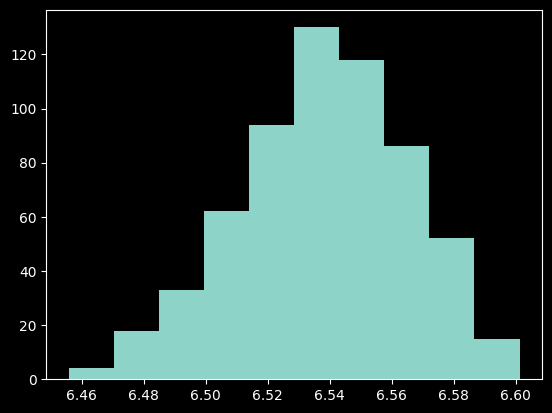

In [16]:
err = [(trk - flps[flps<trk]).min() for trk in trks] #time between the projector and photodiode triggers --- it's about 6.5 lines?
# plt.hist(err)
plt.hist(np.asarray(err)/dx/512)
# dx

In [17]:
fi = 3

d = tif.data().reshape((-1,2,512,516))
print(tif.description(fi))

t = float(re.search("frameTimestamps_sec = (\d+.?\d*)", tif.description(fi)).groups()[0])
Y,X = d.shape[-2:]

dx = float(re.search("SI.hScan2D.scanPixelTimeMean = (\d+.?\d*e?-?\d*)", tif.metadata()).groups()[0])
dy = float(re.search("SI.hRoiManager.linePeriod = (\d+.?\d*e?-?\d*)", tif.metadata()).groups()[0])
bidi = re.search("SI.hScan2D.bidirectional = true", tif.metadata()) is not None
bidi_phase = float(re.search("SI.hScan2D.linePhase = (\d+.?\d*e?-?\d*)", tif.metadata()).groups()[0])


tt = np.zeros((Y,X)) + t

tt += np.arange(0, X)[None, :] * dx
if bidi:
    tt[1::2,:] = np.flip(tt[1::2,:], axis=-1) + bidi_phase # bidiscanning
tt += np.arange(0, Y)[:, None] * dy

print('ch 1 (60Hz)') 
tmp = re.search('auxTrigger1 = \[((?:-?\d+.?\d+\s?\,?)+)\]', tif.description(fi))
tmp = [float(x) for x in tmp.groups()[0].split(' ,')]
for tr in tmp:
    print(np.unravel_index(np.abs(tt - tr).argmin(), tt.shape))

print('ch 2 (30Hz)')
tmp = re.search('auxTrigger0 = \[((?:-?\d+.?\d+\s?\,?)+)\]', tif.description(fi))
tmp = [float(x) for x in tmp.groups()[0].split(' ,')]
for tr in tmp:
    print(np.unravel_index(np.abs(tt - tr).argmin(), tt.shape))




frameNumbers = 79202
acquisitionNumbers = 1
frameNumberAcquisition = 79202
frameTimestamps_sec = 2645.033701770
acqTriggerTimestamps_sec = -1.000000000
nextFileMarkerTimestamps_sec = -1.000000000
endOfAcquisition = 0
endOfAcquisitionMode = 0
dcOverVoltage = 0
epoch = [2023  9 15 17 12 30.487]
auxTrigger0 = [2645.053661350 ,2645.053661600 ,2645.053661900 ,2645.053662035 ,2645.053662235 ,2645.053662385 ,2645.053662585 ]
auxTrigger1 = [2645.036688810 ,2645.053370425 ]
auxTrigger2 = []
auxTrigger3 = []
I2CData = {}
                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                   

In [19]:
# print(tif.description(2))
flps.shape, trks.shape
float(re.search("frameTimestamps_sec = (\d+.?\d*)", tif.description(fi)).groups()[0]) - float(re.search("frameTimestamps_sec = (\d+.?\d*)", tif.description(fi - 2)).groups()[0])


0.0

In [213]:
# 1/(tt.flat[-1] - tt.flat[0])
2645.033701770 - tt.flat[-1]
# (1/dy)/512
# Y,X

0.0010405411999272474

C:\Users\zfj\AppData\Local\Temp\ipykernel_5048\296097073.py:8: RuntimeWarning: Mean of empty slice
  plt.plot(np.nanmean(e.func[(e.events.iloc[i].pre_on //(32*256)): (e.events.iloc[i].tail_off //(32*256))], axis=(1,2)))


[16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55]


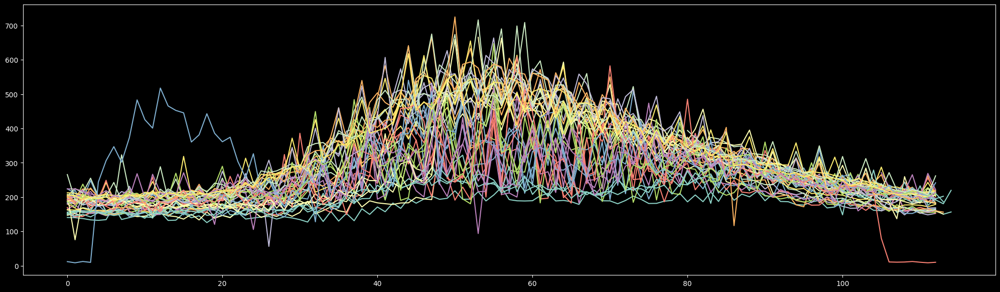

In [54]:

plt.figure(figsize=(25,7))

b = []
for i,d in e.events.iterrows():
    # if d.trial_type == b'chirp':
    if d.trial_type == b'bars':
        b.append(i)
        plt.plot(np.nanmean(e.func[(e.events.iloc[i].pre_on //(32*256)): (e.events.iloc[i].tail_off //(32*256))], axis=(1,2)))
    # plt.plot(np.nanmean(e.func[(e.events.iloc[i].pre_on //(32*256))+180: (e.events.iloc[i].pre_on //(32*256))+210], axis=(1,2)))
    # plt.show()
    # plt.imshow(e.func[(e.events.iloc[i].pre_on //(32*256)) + 183], aspect=8, interpolation='none')
print(b)

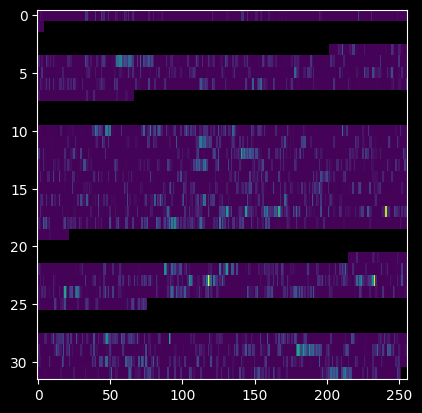

In [62]:
bi = b[0]
plt.imshow(e.func[(e.events.iloc[bi].pre_on //(32*256)) + 46], aspect=8, interpolation='none')

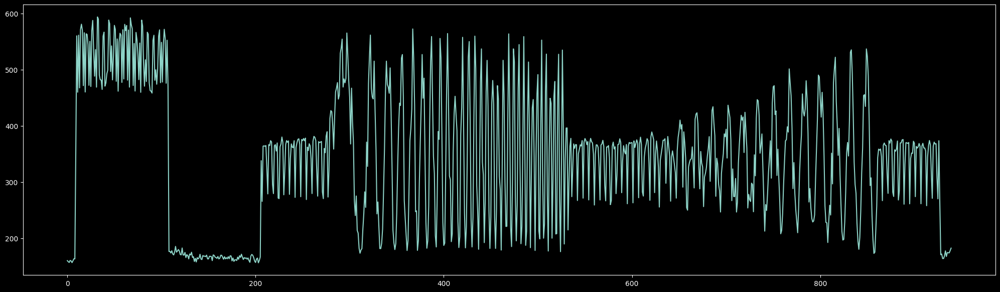

In [91]:
plt.figure(figsize=(25,7))

plt.plot(np.nanmean(e.func[43080:44020],axis=(1,2)))

# 43080*256*32, 44020*256*32

C:\Users\zfj\AppData\Local\Temp\ipykernel_17040\1717806960.py:3: RuntimeWarning: Mean of empty slice
  plt.plot(np.nanmean(e.func[(t.pre_on//(32*256)) : (t.tail_off//(32*256))], axis=(1,2)))


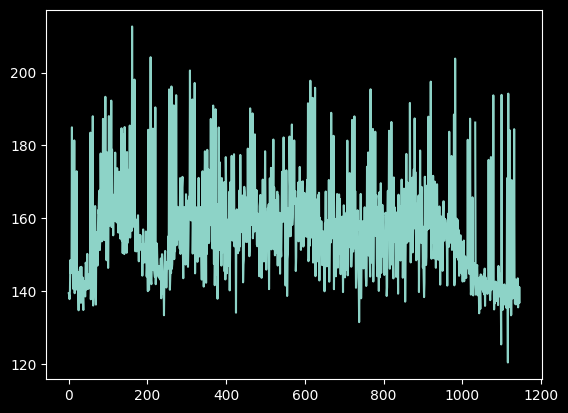

In [141]:
t = e.events[e.events.trial_type==b'chirp'].iloc[0]

plt.plot(np.nanmean(e.func[(t.pre_on//(32*256)) : (t.tail_off//(32*256))], axis=(1,2)))
# t.pre_on//(32*256), t.tail_off//(32*256)

In [5]:
func = np.load("C:\\Users\\zfj\\data\\081023B\\func\\region1_927nm_00001_functional2.npy").reshape((-1,32,256))

C:\Users\zfj\AppData\Local\Temp\ipykernel_17844\1184855556.py:2: RuntimeWarning: Mean of empty slice
  plt.plot(np.nanmean(func[37500:44500], axis=(1,2)))


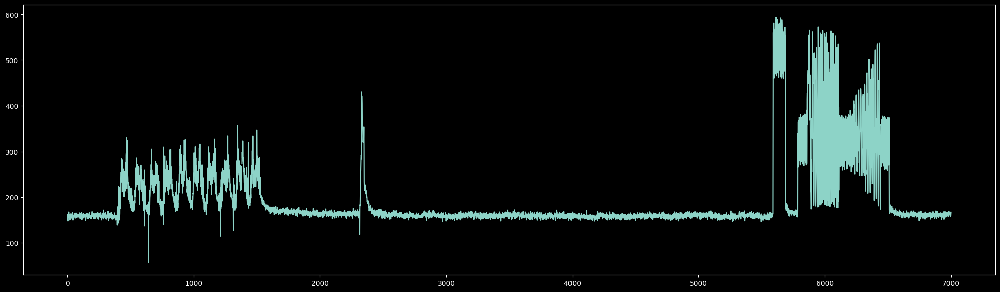

In [6]:
plt.figure(figsize=(25,7))
plt.plot(np.nanmean(func[37500:44500], axis=(1,2)))

C:\Users\zfj\AppData\Local\Temp\ipykernel_5048\1580922463.py:2: RuntimeWarning: Mean of empty slice
  plt.plot(np.nanmean(e.func[37500:44500], axis=(1,2)))


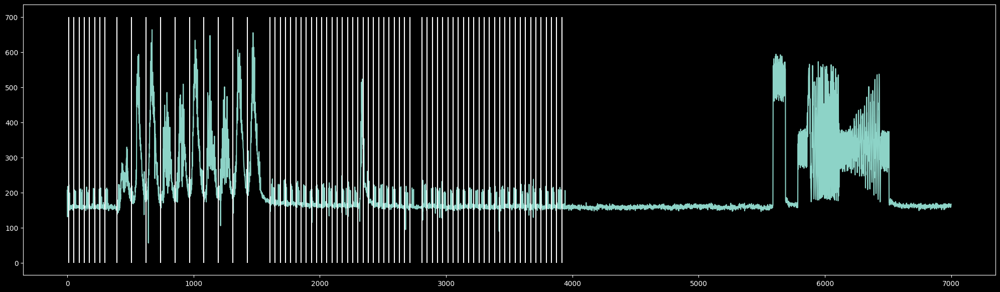

In [63]:
plt.figure(figsize=(25,7))
plt.plot(np.nanmean(e.func[37500:44500], axis=(1,2)))

# f = np.concatenate(e.events.flips.tolist())
v = e.events[(e.events.pre_on < 44500*32*256) & (e.events.pre_on > 37500*32*256)]

# f = np.concatenate(f.flips.tolist())
# e.events
plt.vlines(v.stim_on /(32*256) - 37500, 0, 700, 'w')

# 37500*32*256, 44500*32*256
# v


In [64]:
v

,pre_on,stim_on,stim_off,tail_off,pre_on_i,stim_on_i,stim_off_i,tail_off_i,epoch_id,start_time,...,spotStimFrames,spotTailFrames,stimTime,stimTimeRecord,tailTime,LED,intensity,end_time,flips,frame_indices
26,310355653,310422839,311228693,311295911,3,15,194,209,89,638272717221587638,...,15.0,45.0,35000.0,0,0.0,50.0,0.125,638272717571587638,"[310355653, 310373626, 310378237, 310382589, 3...","[3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ..."
27,311309238,311362813,312168698,312235879,213,225,404,419,89,638272717221587638,...,15.0,45.0,35000.0,0,0.0,50.0,0.125,638272717571587638,"[310355653, 310373626, 310378237, 310382589, 3...","[3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ..."
28,312249210,312303098,313108667,313175855,423,435,614,629,89,638272717221587638,...,15.0,45.0,35000.0,0,0.0,50.0,0.125,638272717571587638,"[310355653, 310373626, 310378237, 310382589, 3...","[3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ..."
29,313189183,313243069,314048639,314115837,633,645,824,839,89,638272717221587638,...,15.0,45.0,35000.0,0,0.0,50.0,0.125,638272717571587638,"[310355653, 310373626, 310378237, 310382589, 3...","[3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ..."
30,314129437,314183041,314988893,315056114,843,855,1034,1049,89,638272717221587638,...,15.0,45.0,35000.0,0,0.0,50.0,0.125,638272717571587638,"[310355653, 310373626, 310378237, 310382589, 3...","[3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
611,337881152,337935039,338001943,338203562,1728,1740,1754,1799,87,638272717958302852,...,15.0,45.0,35000.0,0,0.0,50.0,0.125,638272718308302852,"[330145829, 330163798, 330168423, 330172776, 3...","[3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ..."
612,338216893,338270748,338337786,338539271,1803,1815,1829,1874,87,638272717958302852,...,15.0,45.0,35000.0,0,0.0,50.0,0.125,638272718308302852,"[330145829, 330163798, 330168423, 330172776, 3...","[3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ..."
613,338552606,338606493,338673658,338875016,1878,1890,1904,1949,87,638272717958302852,...,15.0,45.0,35000.0,0,0.0,50.0,0.125,638272718308302852,"[330145829, 330163798, 330168423, 330172776, 3...","[3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ..."
614,338888342,338942205,339009414,339210746,1953,1965,1979,2024,87,638272717958302852,...,15.0,45.0,35000.0,0,0.0,50.0,0.125,638272718308302852,"[330145829, 330163798, 330168423, 330172776, 3...","[3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ..."


In [65]:
v[v.trial_type==b'bars']

,pre_on,stim_on,stim_off,tail_off,pre_on_i,stim_on_i,stim_off_i,tail_off_i,epoch_id,start_time,...,spotStimFrames,spotTailFrames,stimTime,stimTimeRecord,tailTime,LED,intensity,end_time,flips,frame_indices
26,310355653,310422839,311228693,311295911,3,15,194,209,89,638272717221587638,...,15.0,45.0,35000.0,0,0.0,50.0,0.125,638272717571587638,"[310355653, 310373626, 310378237, 310382589, 3...","[3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ..."
27,311309238,311362813,312168698,312235879,213,225,404,419,89,638272717221587638,...,15.0,45.0,35000.0,0,0.0,50.0,0.125,638272717571587638,"[310355653, 310373626, 310378237, 310382589, 3...","[3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ..."
28,312249210,312303098,313108667,313175855,423,435,614,629,89,638272717221587638,...,15.0,45.0,35000.0,0,0.0,50.0,0.125,638272717571587638,"[310355653, 310373626, 310378237, 310382589, 3...","[3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ..."
29,313189183,313243069,314048639,314115837,633,645,824,839,89,638272717221587638,...,15.0,45.0,35000.0,0,0.0,50.0,0.125,638272717571587638,"[310355653, 310373626, 310378237, 310382589, 3...","[3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ..."
30,314129437,314183041,314988893,315056114,843,855,1034,1049,89,638272717221587638,...,15.0,45.0,35000.0,0,0.0,50.0,0.125,638272717571587638,"[310355653, 310373626, 310378237, 310382589, 3...","[3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ..."
31,315069434,315123014,315928865,315996082,1053,1065,1244,1259,89,638272717221587638,...,15.0,45.0,35000.0,0,0.0,50.0,0.125,638272717571587638,"[310355653, 310373626, 310378237, 310382589, 3...","[3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ..."
32,316009413,316063267,316868861,316936059,1263,1275,1454,1469,89,638272717221587638,...,15.0,45.0,35000.0,0,0.0,50.0,0.125,638272717571587638,"[310355653, 310373626, 310378237, 310382589, 3...","[3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ..."
33,316949385,317003260,317808841,317876026,1473,1485,1664,1679,89,638272717221587638,...,15.0,45.0,35000.0,0,0.0,50.0,0.125,638272717571587638,"[310355653, 310373626, 310378237, 310382589, 3...","[3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ..."
34,317889640,317943244,318749095,318816253,1683,1695,1874,1889,89,638272717221587638,...,15.0,45.0,35000.0,0,0.0,50.0,0.125,638272717571587638,"[310355653, 310373626, 310378237, 310382589, 3...","[3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ..."
35,318829611,318883216,319689067,319751653,1893,1905,2084,2098,89,638272717221587638,...,15.0,45.0,35000.0,0,0.0,50.0,0.125,638272717571587638,"[310355653, 310373626, 310378237, 310382589, 3...","[3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ..."


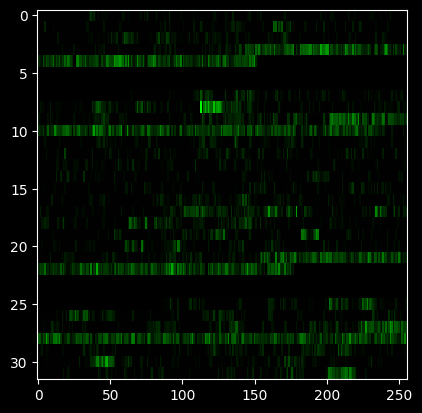

In [133]:
plt.imshow(e.func[38500], aspect=8, interpolation='none', cmap=LinearSegmentedColormap.from_list("Green", [(0,0,0), (0,1,0)]))

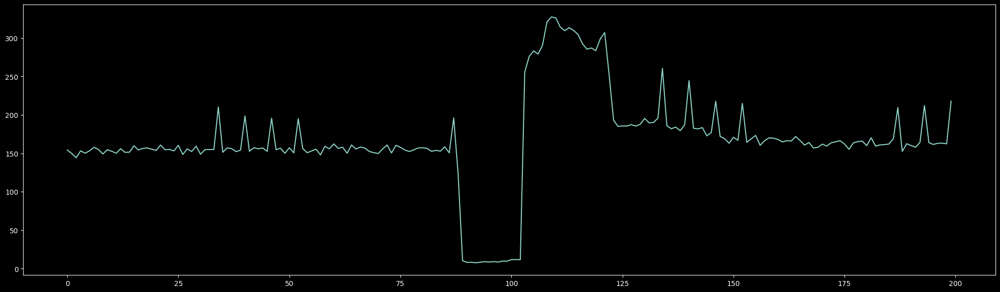

In [59]:
plt.figure(figsize=(25,7))
plt.plot(np.nanmean(e.func[30900:31100],axis=(1,2)))

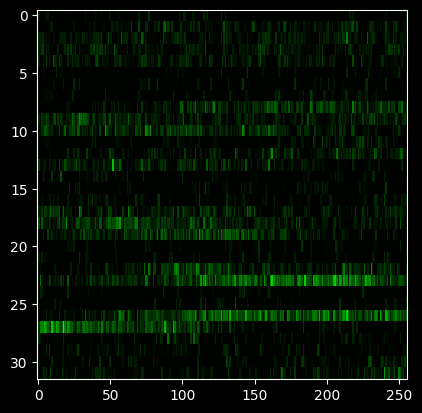

In [86]:
plt.imshow(e.func[31014], aspect=8, interpolation='none', cmap=LinearSegmentedColormap.from_list("Green", [(0,0,0), (0,1,0)]))

MovieWriter ffmpeg unavailable; using Pillow instead.


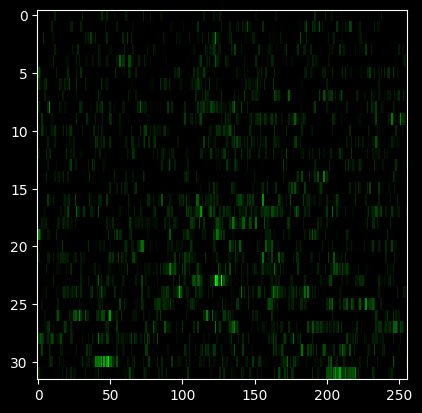

In [10]:
# 44800:45300 # unknown
# 43080:44020 #chirp_artifact

# 37500:44500

t0,tf = 37500,44500
# t0,tf = 44800,45300
name = "spots_and_bars_fixed"


fig = plt.figure()
# i = np.random.randint(0,reg_anat.shape[0])
# i= 30900

im = plt.imshow(func[t0], aspect=8, interpolation='none', cmap=LinearSegmentedColormap.from_list("Green", [(0,0,0), (0,1,0)]))
low, hi = np.nanpercentile(func[t0:tf], [2,99.9])
plt.clim(low, hi)


def animate(i):
    im.set_data(func[t0+i])
    return [im]

anim = animation.FuncAnimation(fig, animate, frames = tf-t0, interval = 1000/32.8)
anim.save(os.path.join(bin_path, name + '.gif'),fps = 32.8)

In [36]:
import os
# os.listdir(f"C:\\Users\\zfj\\data\\{exp_name}\\")
# [os.path.join(f"C:\\Users\\zfj\\data\\{exp_name}\\",i) for i in ['region1_00001.tif',
#  'region1_00002.tif',
#  'region1_00003.tif',]]

events = pd.read_parquet(f"C:\\Users\\zfj\\data\\{exp_name}\\func\\region1_00003_events.parquet")
np.concatenate(events.frame_indices.tolist()).shape
# for i,s in events.iterrows():
#     plt.plot(s.frame_indices)
#     if len(s.frame_indices) < 2000:
#         print('empty event')
#     else:
#     #     print(s.frame_indices.dtype)
#         print(s.frame_indices.shape)
#     if s.frame_indices.dtype != np.int32:
#         print('!')

(2219664,)

In [12]:
import suite2p

exp_name = "071323B"
stack = f"C:\\Users\\zfj\\data\\{exp_name}\\071323B_region1_stack_red_max_vitreousmasked.tif"

t,_ = suite2p.io.tiff.open_tiff(stack, sktiff = 0)


In [47]:
# suite2p.io.BinaryRWFile
suite2p.io.BinaryRWFile

AttributeError: module 'suite2p.io' has no attribute 'BinaryRWFile'

In [13]:
(*t.shape(),)
# t.shape()

(512, 512)

In [4]:
# e.func.reshape((-1,32,256))[(e.events.pre_on[0]//(32*256)):(e.events.tail_off[0]//(32*256))].shape
# e.props['frame_shape'] = (32,256)
ifunc = e.func.copy().reshape((-1,32,256))
# ianat = tif.data().reshape((-1,4,32,128))[:,0,:,:].copy().astype(np.double)
from scipy.interpolate import interp1d

# for i in range(e.props['frame_shape'][0]):
#     for j in range(e.props['frame_shape'][1]):
for i in range(32):
    for j in range(256):
        n = np.isnan(ifunc[:,i,j])
        ifunc[n,i,j] = interp1d(np.nonzero(~n)[0], ifunc[~n,i,j], fill_value='extrapolate')(np.nonzero(n)[0])
        # ianat[n,i,j] = interp1d(np.nonzero(~n)[0], ianat[~n,i,j], fill_value='extrapolate')(np.nonzero(n)[0])


In [22]:
from sklearn.decomposition import PCA

t0 = e.events.stim_on[0]//(32*256)
tf = e.events.stim_off[0]//(32*256)

pca = PCA(n_components=15)
comps = pca.fit_transform(ifunc.reshape((-1,32*256))[t0:tf])


In [26]:
ifunc.shape

(42389, 32, 256)

3429


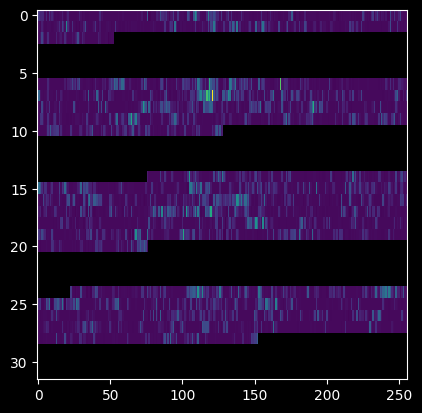

In [31]:
# t0 = e.events.pre_on[0]//(32*256)
# plt.imshow(e.func.reshape((-1,32,256))[t0+1], aspect=8, interpolation='none')
plt.imshow(e.func.reshape((-1,32,256))[t0+2], aspect=8, interpolation='none')

print(t0)

In [72]:
import os
os.path.splitext(os.path.split(raw_file)[-1])[0] + '_anat.bin'

'region1_00001_anat.bin'

In [22]:
# import struct

# binary = "1111111111111111111111111111111111111111111111111111111111111111"
binary = "1111111111111111111111111111111111111111111111111111111111111111"
struct.unpack('!d',struct.pack('!Q', int(binary, 2)))
# struct.unpack('!f',struct.pack('!I',int("111",2)))
# int(binary,2)

(nan,)

6859 8700


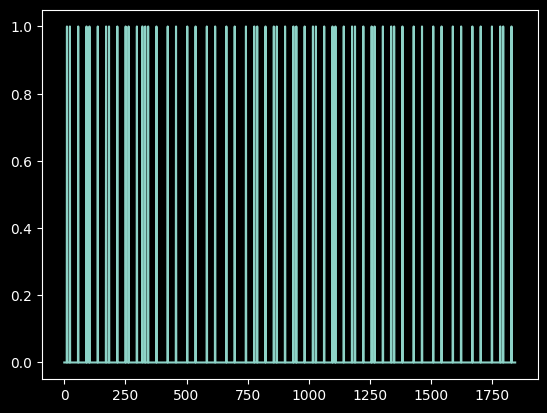

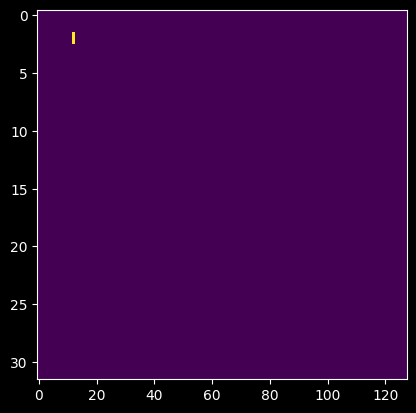

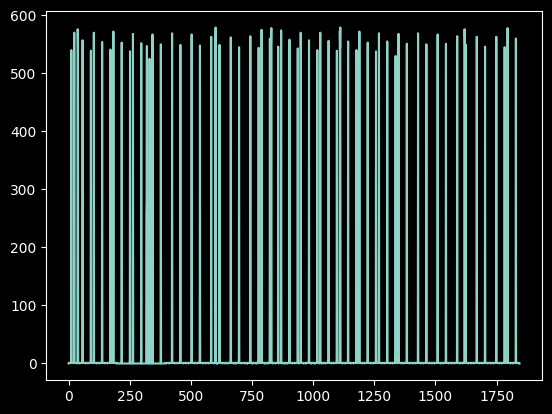

In [9]:
# ind0 = e.events[e.events.trial_type==b'bars'].stim_on.iloc[0] // (32*128)
# ind1 = e.events[e.events.trial_type==b'bars'].stim_off.iloc[0] // (32*128)
ind0 = e.events[e.events.trial_type==b'chirp'].stim_on.iloc[0] // (32*128)
ind1 = e.events[e.events.trial_type==b'chirp'].stim_off.iloc[0] // (32*128)
# ind0 = e.events[e.events.trial_type==b'chirp'].stim_on.iloc[0] // (32*128)
# ind1 = e.events[e.events.trial_type==b'chirp'].stim_off.iloc[0] // (32*128)
print(ind0,ind1)

# plt.imshow(e.func.reshape((-1,32,128))[ind+4], aspect=4, interpolation='none')
plt.plot(np.isnan(e.func.reshape((-1,32,128))[ind0 - 2 :ind1 + 2, 1,16]))
plt.show()

plt.imshow(np.isnan(e.func.reshape((-1,32,128))[ind0+10]), aspect=4, interpolation='none')
plt.show()


plt.plot(np.isnan(e.func.reshape((-1,32,128))[ind0 -2 : ind1 + 2]).sum(axis=(1,2)))



In [10]:
# e.func.dtype
import struct
struct.unpack(">d", struct.pack(">l", np.iinfo(np.uint64).max))[0]
# np.iinfo(np.uint64).max

error: argument out of range

In [11]:
e.epochs.end_time = e.epochs.start_time + np.uint64((e.epochs.preTime + e.epochs.stimTime + e.epochs.tailTime) * 1e4)
e.epochs = e.epochs.sort_values('start_time')

AttributeError: 'Experiment' object has no attribute 'epochs'

In [12]:
type(e.epochs)

AttributeError: 'Experiment' object has no attribute 'epochs'

In [4]:
%%cython -a
import numpy as np
cimport numpy as np


ctypedef np.uint64_t DTYPE_t
cimport cython
@cython.boundscheck(False) # turn off bounds-checking for entire function
@cython.wraparound(False)  # turn off negative index wrapping for entire function
def align_frames_to_epochs(np.ndarray[DTYPE_t, ndim=1] frames, np.ndarray[DTYPE_t, ndim=1] starts, np.ndarray[DTYPE_t, ndim=1] ends):
    '''
    Assumes that all three vectors are in ascending order
    '''
    cdef np.ndarray[np.int64_t, ndim=2] frame_i = np.ones((starts.shape[0],2), dtype=np.int64) * -1

    cdef int i = 0
    cdef int j = 0

    cdef int ne = len(starts)
    cdef int nf = len(frames)

    while frames[i] > starts[j]: # the early frames might occur after the early epochs
        j += 1

    while j < ne:
        while frames[i] < starts[j]:
            i += 1
            if i == nf:
                return frame_i
        frame_i[j,0] = i - 1

        while frames[i] < ends[j]:
            i += 1
            if i == nf:
                return frame_i
        frame_i[j,1] = i - 1
        j += 1
    return frame_i


In [83]:
# %timeit -n100 -r100 align_frames_to_epochs(e.props['time_stamps'], t.iloc[0][0].to_numpy(),t.iloc[0][1].to_numpy())
fi = align_frames_to_epochs(e.props['time_stamps'], e.epochs.start_time.to_numpy(),e.epochs.end_time.to_numpy())
fip = fi[fi>0]
fip = fip[:(len(fip)//2)*2]

fip = fip.reshape((-1,2))


In [6]:
from sklearn.cluster import KMeans
def cluster_trigger_events( begin, end, projector_frame_rate=60.0):
    trigger = e.trigger[begin:end]
    flips = e.flips[np.logical_and(e.flips >= begin, e.flips < end)] - begin

    lv = np.asarray([trigger[flips[i-1]:flips[i]].mean() for i in range(1, len(flips))]).reshape((-1,1))
    
    #ignore the first 10 flips as (possibly) belonging to the start trigger
    km = KMeans(n_clusters=4, algorithm='elkan').fit(lv[10:])
    fl = km.predict(lv)
    idx = np.argsort(km.cluster_centers_.flatten())
    lut = np.zeros_like(idx)
    lut[idx] = np.arange(len(idx))
    fl = [0, *lut[fl]]

    fi = np.empty(len(flips), dtype=int)
    fi[0] = -1

    rm = []
    last_fl = 0
        
    for i in range(1,len(fl)):
        if (flips[i] - flips[i-1] < e.props['pixel_rate']/(projector_frame_rate * 7/3)) or (i<len(fl)-1 and fl[i] == fl[i+1]):
            #false transition: frames cannot come this close together
            rm.append(i) # keep track of this frame to delete later
            continue
        elif fl[i] == 0: # frame is divisible by 4
            fi[i] = ((fi[last_fl] + 4)//4)*4
        elif fl[i] == 3: # frame % 4 == 3
            if not last_fl or (fi[last_fl] == -1 and flips[i] - flips[last_fl] > e.props['pixel_rate']/projector_frame_rate * 5): #either a skip, or the start trigger
                fi[i] = 3 # cannot distinguish the first 4 frames
            else:
                fi[i] = ((fi[last_fl] + 3)//4)*4 + 1
        elif fl[i] == 1: # frame % 4 == 1
            fi[i] = ((fi[last_fl] + 2)//4)*4 + 2
        elif fl[i] == 2: # frame % 4 == 2
            fi[i] = ((fi[last_fl] + 1)//4)*4 + 3
        else:
            print('!')
        
        # last_flip = flips[i]
        last_fl = i    

    flips = np.delete(flips, rm)
    fl = np.delete(fl, rm) # not used?
    fi = np.delete(fi, rm)[1:]

    # dropped = np.where(np.diff(fi)>1)[0]

    trial_i = np.logical_and(fi[:-1]<3, fi[1:]==3)

    dropped_i = np.logical_and(np.diff(fi, prepend=-1) > 1, fi>=0)
    dropped_i = np.logical_and(dropped_i[:-1], ~trial_i)
    dropped = flips[np.argwhere(dropped_i)]

    # #TODO: known issues with dropping:
    # #   - doesn't correctly handle consecutive frame drops ?
    # #   - we frequnetly drop the second-to-last frame ?
    # #   - claims that frames are dropped when there are false triggers


    # trials = flips[np.diff(fi[flips], prepend=-1) < 0]
    trials = flips[np.argwhere(trial_i)]

    if len(dropped):
        print(f"Dropped {len(dropped)} frames in {len(trials)} trials ({len(dropped)/(len(flips) + len(dropped)) * 100:.03f}%)")

    return fi, flips + begin, fl, dropped + begin, trials + begin, km


In [84]:
# tfi, tflips, _, _, ttrials, _ = zip(*[cluster_trigger_events((start-16)*32*128, (end+16)*32*128) for start, end in fip])
e.epochs['flips'] = None
e.epochs['frame_indices'] = None
for i, (start, end) in enumerate(fi):
    if start<0 or end<0:
        continue
    tfi, tflips, *_= cluster_trigger_events((start-16)*32*128, (end+16)*32*128)
    e.epochs.iat[i, e.epochs.columns.get_loc('flips')] = tflips
    e.epochs.iat[i, e.epochs.columns.get_loc('frame_indices')] = tfi

    # plt.plot(tfi)
    

Dropped 1 frames in 0 trials (0.048%)
Dropped 1 frames in 0 trials (0.048%)
Dropped 1 frames in 0 trials (0.048%)
Dropped 1 frames in 0 trials (0.048%)
Dropped 1 frames in 0 trials (0.048%)
Dropped 1 frames in 0 trials (0.048%)
Dropped 1 frames in 0 trials (0.048%)
Dropped 1 frames in 0 trials (0.048%)
Dropped 1 frames in 0 trials (0.048%)
Dropped 1 frames in 0 trials (0.048%)
Dropped 1 frames in 0 trials (0.048%)
Dropped 1 frames in 0 trials (0.048%)
Dropped 1 frames in 0 trials (0.048%)
Dropped 1 frames in 0 trials (0.048%)
Dropped 1 frames in 0 trials (0.048%)
Dropped 1 frames in 0 trials (0.048%)
Dropped 1 frames in 0 trials (0.048%)
Dropped 1 frames in 0 trials (0.048%)
Dropped 1 frames in 0 trials (0.048%)
Dropped 1 frames in 0 trials (0.048%)
Dropped 1 frames in 0 trials (0.048%)
Dropped 1 frames in 0 trials (0.048%)
Dropped 1 frames in 0 trials (0.048%)
Dropped 1 frames in 0 trials (0.048%)
Dropped 1 frames in 0 trials (0.048%)
Dropped 1 frames in 0 trials (0.048%)


In [85]:
## this method returns some false positives
# sidx = tflips.argsort()
# idx = np.searchsorted(tflips, e.flips,sorter=sidx)
# idx[idx==len(tflips)] = 0
# missing = e.flips[tflips[sidx[idx]] != e.flips]
found_i = np.any(np.stack([np.logical_and(e.flips >= (start-16)*32*128, e.flips < (end+16)*32*128) for start, end in fip]), axis=0)
missing = e.flips[~found_i]
found =e.flips[found_i]

In [9]:
%%cython -a

import numpy as np
cimport numpy as np

ctypedef np.int64_t DTYPE_t
cimport cython
@cython.boundscheck(False) # turn off bounds-checking for entire function
@cython.wraparound(False)  # turn off negative index wrapping for entire function
def cluster_frames(np.ndarray[DTYPE_t, ndim=1] missing, int separation):
    '''
    Assumes that missing values are in ascending order
    '''
    
    cdef int ne = len(missing)
    cdef np.ndarray[np.uint8_t, ndim=1, cast=True] boundary = np.zeros(ne, dtype=np.bool)

    boundary[0] = True
    boundary[ne-1] = True

    cdef int i = 1
    while i < ne:
        if missing[i] - missing[i-1] > separation:
            boundary[i] = True
            boundary[i-1] = True
        i+=1
    
    return boundary


In [86]:
# %timeit -n100 -r100 cluster_missing_frames(missing, int(e.props['pixel_rate']))
bounds = cluster_frames(missing, int(e.props['pixel_rate']/8))
bounds_f = cluster_frames(found, int(e.props['pixel_rate']/8))

C:\Users\zfj\AppData\Local\Temp\ipykernel_3612\999738502.py:2: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  bounds = cluster_frames(missing, int(e.props['pixel_rate']/8))
C:\Users\zfj\AppData\Local\Temp\ipykernel_3612\999738502.py:3: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  bounds_f = cluster_frames(found, int(e.props['pixel_rate']/8))


In [87]:
bounds_i = np.argwhere(bounds).flatten()
bounds_ii = np.asarray([(bounds_i[i-1], bounds_i[i]) for i in range(1,len(bounds_i)) if bounds_i[i] - bounds_i[i-1] > 1])

bounds_fi = np.argwhere(bounds_f).flatten()
bounds_fii = np.asarray([(bounds_fi[i-1], bounds_fi[i]) for i in range(1,len(bounds_fi)) if bounds_fi[i] - bounds_fi[i-1] > 1])


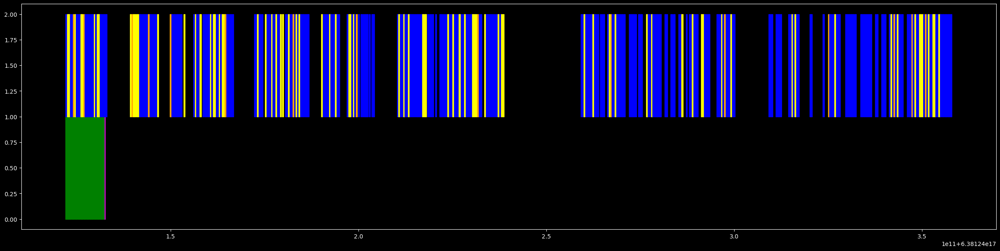

In [88]:
plt.figure(figsize=(30,7))

for start,end in bounds_ii:
    plt.fill_between([e.props['time_stamps'][missing[start]//(32*128)], e.props['time_stamps'][missing[end]//(32*128)]],0,1, color='m')


for start,end in bounds_fii:
    plt.fill_between([e.props['time_stamps'][found[start]//(32*128)], e.props['time_stamps'][found[end]//(32*128)]],0,1, color='g')

# c = ['b','y','o']
for i,epoch in e.epochs.iterrows():
    if epoch.trial_type == b'field':
        ci = 'blue'
    elif epoch.trial_type == b'chirp':
        ci = 'yellow'
    elif epoch.trial_type == b'bars':
        ci = 'orange'
    plt.fill_between([epoch.start_time, epoch.end_time],1,2,color=ci)


In [89]:
bounds_i = np.argwhere(bounds).flatten()
mfi, mflips, _, _, mtrials, mkm = zip(*[cluster_trigger_events(missing[bounds_i[i-1]], missing[bounds_i[i]]) for i in range(1,len(bounds_i)) if bounds_i[i] - bounds_i[i-1] > 1])


Dropped 1 frames in 0 trials (0.049%)


In [90]:
#now let's add some trials to e.epochs with nan entries except for the start_time?
#i also want to make some kind of map from the epochs to the flip/frame indices...

ttrials = mtrials

ls = (np.asarray(ttrials).flatten()//128) % 32
ts = e.props['time_stamps'][np.asarray(ttrials).flatten()//(32*128)] - (1e7/e.props['line_rate'] * (32 - ls)).astype(np.int64)# + (1e7/e.props['pixel_rate'] * (np.asarray(ttrials).flatten() % 128)).astype(np.int64) # bidi?
ts[ls % 2 == 0] -= (1e7/e.props['pixel_rate'] * (128 - np.asarray(ttrials).flatten()[ls % 2 == 0] % 128)).astype(np.int64)
ts[ls % 2 == 1] -= (1e7/e.props['pixel_rate'] * (np.asarray(ttrials).flatten()[ls % 2 == 1] % 128)).astype(np.int64)
d = ts[:,None] - e.epochs.start_time.to_numpy().astype(np.int64)[None,:]
di = np.argmin(np.abs(d), axis=1)

np.median([d[i,di[i]] for i in range(len(di))])


ls = (np.concatenate(mtrials)//128) % 32
ts = e.props['time_stamps'][np.concatenate(mtrials)//(32*128)] - (1e7/e.props['line_rate'] * (32 - ls)).astype(np.int64)# + (1e7/e.props['pixel_rate'] * (np.asarray(ttrials).flatten() % 128)).astype(np.int64) # bidi?
ts[ls % 2 == 0] -= (1e7/e.props['pixel_rate'] * (128 - np.concatenate(mtrials)[ls % 2 == 0] % 128)).astype(np.int64)
ts[ls % 2 == 1] -= (1e7/e.props['pixel_rate'] * (np.concatenate(mtrials)[ls % 2 == 1] % 128)).astype(np.int64)


c:\Users\zfj\anaconda3\envs\suite2p\lib\site-packages\numpy\core\fromnumeric.py:3474: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
c:\Users\zfj\anaconda3\envs\suite2p\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


In [91]:
# can't really add new rows to the df correctly because of the data types
#start time, end time, and bools are the issues
#just have to do this manually when they come up, I guess, though we can still look for them
for c,d in e.epochs.dtypes.items():
    print(c, '\t\t',str(d))

start_time 		 uint64
trial_type 		 object
cx 		 object
cy 		 object
theta 		 object
MstarIntensityBar 		 float64
MstarIntensityChirp 		 float64
MstarIntensitySpot 		 float64
MstarMean 		 float64
NDF 		 float64
RstarIntensityBar 		 float64
RstarIntensityChirp 		 float64
RstarIntensitySpot 		 float64
RstarMean 		 float64
SstarIntensityBar 		 float64
SstarIntensityChirp 		 float64
SstarIntensitySpot 		 float64
SstarMean 		 float64
antialias 		 uint8
barIntensity 		 float64
barLED 		 float64
barLength 		 float64
barWidth 		 float64
bitDepth 		 float64
chan1 		 object
chan1Hold 		 float64
chan1Mode 		 object
chirpIntensity 		 float64
chirpLED 		 float64
chirpSize 		 float64
colorPattern1 		 object
colorPattern2 		 object
colorPattern3 		 object
extentX 		 float64
extentY 		 float64
forcePrerender 		 object
frameRate 		 float64
imaging 		 uint8
meanLevel 		 float64
numberOfBars 		 float64
numberOfChirps 		 float64
numberOfFields 		 float64
numberOfPatterns 		 float64
offsetX 		 float64
offse

In [92]:
def time_events(epochs):
    cols = {
        'pre_on': int, 'stim_on': int, 'stim_off': int, 'tail_off': int,
        'pre_on_i': int, 'stim_on_i': int, 'stim_off_i': int, 'tail_off_i': int, 
        'epoch_id': int
        }
    scols = {**cols, 'cx':np.float64, 'cy':np.float64}
    spots = pd.DataFrame(columns=scols.keys()).astype(scols, copy=False, errors='ignore')
    bcols = {**cols, 'theta':np.float64}
    bars = pd.DataFrame(columns=bcols.keys()).astype(bcols, copy=False, errors='ignore')
    chirps = pd.DataFrame(columns=cols.keys()).astype(cols, copy=False, errors='ignore')

    for i,epoch in epochs.iterrows():
        flips = epoch.flips
        if flips is None:
            continue
        fi = epoch.frame_indices

        # flip_i =np.where(flips==tr)[0][0] # hmmm...
        # flip_i = flips[0]
        # flip_i = 0

        if epoch.trial_type==b'field':
            spot_trial = int(epoch[['spotPreFrames','spotStimFrames','spotTailFrames']].sum())
            spots_per_epoch = 35*60//spot_trial

            spots_t = pd.DataFrame(np.zeros((spots_per_epoch,len(scols))), columns=scols).astype(scols, copy=False, errors='ignore')
            spots_t.epoch_id = i
            pre_i = 0
            on_i = int(epoch.spotPreFrames)
            off_i = int(epoch.spotStimFrames + on_i)
            tail_i = spot_trial
            j = 0
            k = 0

            while j < spots_per_epoch:#k < len(flips):#, flip in enumerate(flips):
                # associate the timing events with the first frame flip that exceeds the requisite frame count
                # specifically, the timing of the named events for each trial will be linked with a linear index into the movie

                #pre_on, pre_on_i
                pre_on = np.argwhere(fi[k:]>=pre_i)[0,0]
                spots_t.iat[j, 0] = flips[k + pre_on]
                spots_t.iat[j, 4] = fi[k + pre_on]
                
                #stim_on, stim_on_i
                stim_on = np.argwhere(fi[k:]>=on_i)[0,0]
                spots_t.iat[j, 1] = flips[k + stim_on]
                spots_t.iat[j, 5] = fi[k + stim_on]

                #stim_off, stim_off_i
                stim_off = np.argwhere(fi[k:]>=off_i)[0,0]
                spots_t.iat[j, 2] = flips[k + stim_off]
                spots_t.iat[j, 6] = fi[k + stim_off - 1]

                tail_off = np.argwhere(fi[k:]>=tail_i)
                if len(tail_off):
                    tail_off = tail_off[0,0]
                else: #we're missing the last flip
                    tail_off = len(flips) - k - 1
                
                spots_t.iat[j, 3] = flips[k + tail_off]
                spots_t.iat[j, 7] = fi[k + tail_off - 1]
                

                spots_t.iat[j, 9] = epoch.cx[j]
                spots_t.iat[j, 10] = epoch.cy[j]


                #increment the trial counter
                k = tail_i
                pre_i += spot_trial
                on_i += spot_trial
                off_i += spot_trial
                tail_i += spot_trial
            
                j+=1
            
            spots = pd.concat([spots, spots_t])
                
        elif epoch.trial_type==b'chirp':
            chirps_t = pd.DataFrame(np.zeros((1,len(cols))), columns=cols).astype(cols, copy=False, errors='ignore')
            chirps_t.epoch_id = i
            
            chirps_t.pre_on= flips[0]
            chirps_t.pre_on_i= fi[0]

            stim_on = np.argwhere(fi>=60*2)[0,0] #TODO: should be frame rate
            chirps_t.stim_on = flips[stim_on]
            chirps_t.stim_on_i = fi[stim_on]

            stim_off = np.argwhere(fi>=60*30)[0,0]
            chirps_t.stim_off = flips[stim_off]
            chirps_t.stim_off_i = fi[stim_off - 1]
            
            tail_off = np.argwhere(fi>=60*35)
            if len(tail_off):
                tail_off = tail_off[0,0]
            else:
                tail_off = len(flips) - 1
            
            chirps_t.tail_off = flips[tail_off]
            chirps_t.tail_off_i = fi[tail_off - 1]

            
            chirps = pd.concat([chirps, chirps_t])

        elif epoch.trial_type==b'bars':            
            bars_t = pd.DataFrame(np.zeros((10,len(bcols))), columns=bcols).astype(bcols, copy=False, errors='ignore')
            bars_t.epoch_id = i            
            
            pre_i = 0
            on_i = 15
            off_i = 195
            tail_i = 210
            j = 0
            k = 0

            while j < 10:#k < len(flips):#, flip in enumerate(flips):
                # associate the timing events with the first frame flip that exceeds the requisite frame count
                # specifically, the timing of the named events for each trial will be linked with a linear index into the movie

                #pre_on, pre_on_i
                pre_on = np.argwhere(fi[k:]>=pre_i)[0,0]
                bars_t.iat[j, 0] = flips[k + pre_on]
                bars_t.iat[j, 4] = fi[k + pre_on]
                
                #stim_on, stim_on_i
                stim_on = np.argwhere(fi[k:]>=on_i)[0,0]
                bars_t.iat[j, 1] = flips[k + stim_on]
                bars_t.iat[j, 5] = fi[k + stim_on]

                #stim_off, stim_off_i
                stim_off = np.argwhere(fi[k:]>=off_i)[0,0]
                bars_t.iat[j, 2] = flips[k + stim_off]
                bars_t.iat[j, 6] = fi[k + stim_off - 1]

                tail_off = np.argwhere(fi[k:]>=tail_i)
                if len(tail_off):
                    tail_off = tail_off[0,0]
                else: #we're missing the last flip
                    tail_off = len(flips) - k - 1
                
                bars_t.iat[j, 3] = flips[k + tail_off]
                bars_t.iat[j, 7] = fi[k + tail_off - 1]
                

                bars_t.iat[j, 9] = epoch.theta[j]


                #increment the trial counter
                k = tail_i
                pre_i += 210
                on_i += 210
                off_i += 210
                tail_i += 210
            
                j+=1
            
            bars = pd.concat([bars, bars_t])
    return spots, chirps, bars

In [93]:
trials = [epoch.flips[0] for _,epoch in e.epochs.iterrows() if epoch.flips is not None]

spots, chirps, bars = time_events(e.epochs)

In [94]:
import suite2p
tif = suite2p.io.tiff.ScanImageTiffReader(raw_file)

In [95]:
func = tif.data().reshape((-1,4,32,128))[:,1,:,:]

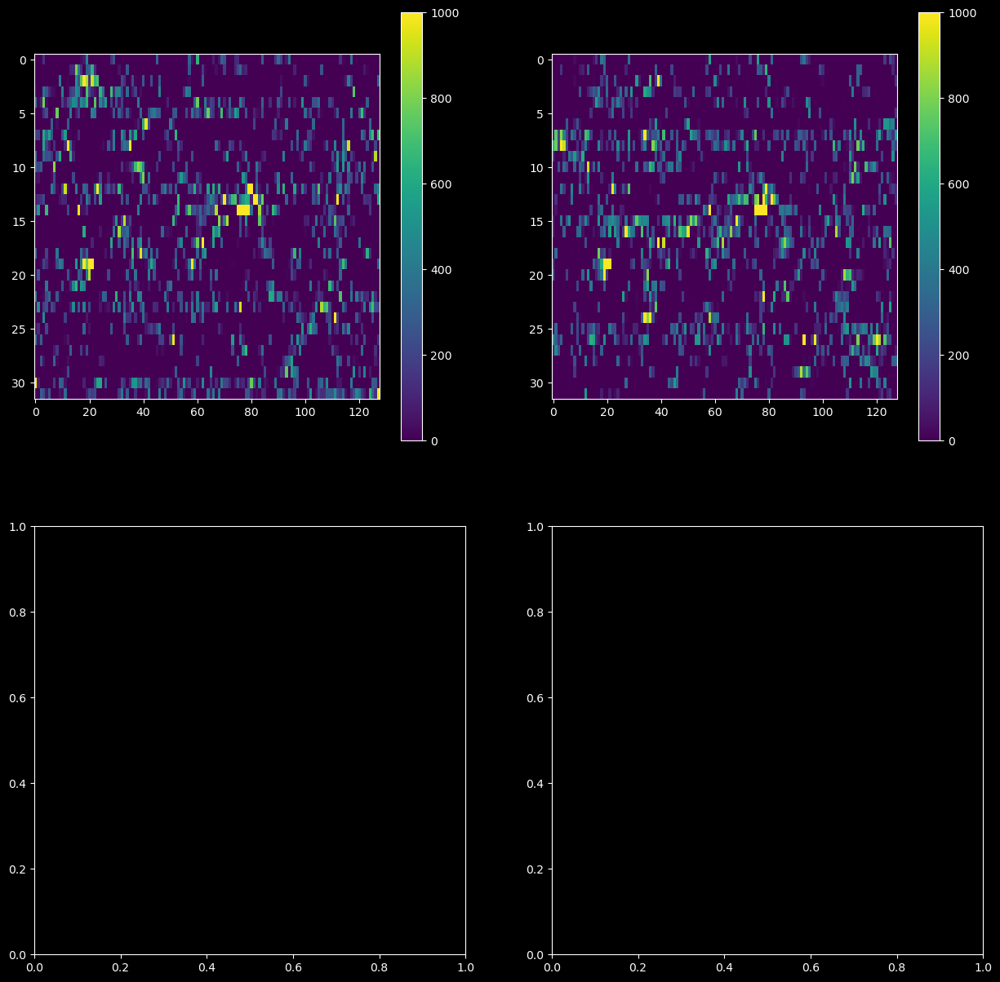

In [96]:
_,axs = plt.subplots(2,2, figsize=(15,15))

plt.sca(axs[0][0])
plt.imshow(func[chirps.stim_on.to_numpy()[1] // (32*128) + 1], aspect=4, interpolation='none')
plt.clim(0,1000)
plt.colorbar()

plt.sca(axs[0][1])
plt.imshow(func[chirps.stim_on.to_numpy()[1] // (32*128) + 2], aspect=4, interpolation='none')
plt.clim(0,1000)
plt.colorbar()

# plt.sca(axs[1][0])
# plt.imshow(func[bars.stim_on.to_numpy()[0] // (32*128) + 151], aspect=4, interpolation='none')
# plt.clim(0,1000)
# plt.colorbar()

# plt.sca(axs[1][1])
# plt.imshow(func[bars.stim_on.to_numpy()[0] // (32*128) + 152], aspect=4, interpolation='none')
# plt.clim(0,1000)
# plt.colorbar()

['#8dd3c7', '#feffb3', '#bfbbd9', '#fa8174', '#81b1d2', '#fdb462', '#b3de69', '#bc82bd', '#ccebc4', '#ffed6f']


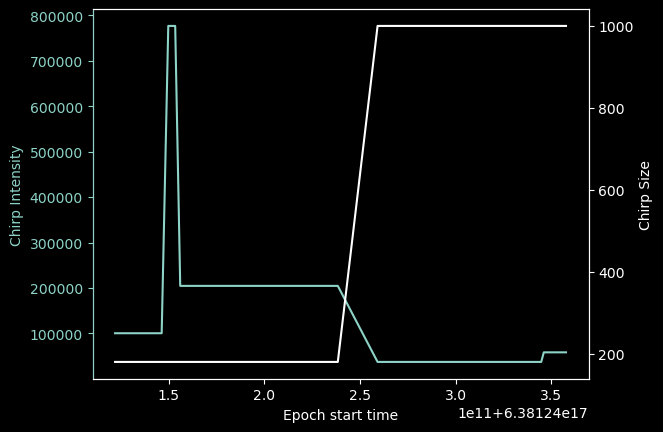

In [61]:
print(plt.rcParams['axes.prop_cycle'].by_key()['color'])
# e.epochs.RstarIntensityChirp
plt.plot(e.epochs.sort_values('start_time').start_time, e.epochs.sort_values('start_time').RstarIntensityChirp)
plt.ylabel('Chirp Intensity', color=plt.rcParams['axes.prop_cycle'].by_key()['color'][0])
plt.yticks(color = plt.rcParams['axes.prop_cycle'].by_key()['color'][0])

plt.gca().tick_params(axis='y', colors=plt.rcParams['axes.prop_cycle'].by_key()['color'][0])

plt.xlabel('Epoch start time')

plt.twinx()
plt.plot(e.epochs.sort_values('start_time').start_time, e.epochs.sort_values('start_time').chirpSize,'w')
plt.ylabel('Chirp Size')
# plt.

plt.gca().spines['left'].set_color(plt.rcParams['axes.prop_cycle'].by_key()['color'][0])


In [97]:
class intervals:
    def __init__(self, array):
        self.i = 0
        self.N = len(array)
        self.array = array
    def __iter__(self):
        return self
    def __next__(self):
        self.i += 1
        if self.i < self.N:
            return self.array[self.i-1], self.array[self.i]
        raise StopIteration

In [98]:
def chirp_pattern(intensity, sf = 60):
   sf = int(sf)
   chirp = np.concatenate((
        np.zeros(2*sf), #pre time
        np.ones(3*sf), #positive step
        np.zeros(3*sf), #negative time
        np.ones(2*sf) * 0.5, #inter time
        
        -np.sin(2*np.pi*np.linspace(0,8/sf,sf*8).cumsum() + np.pi)/2 + .5, # freq chirp

        np.ones(2*sf) * 0.5, #inter time
        -np.linspace(0,1,sf*8)*np.sin(2*np.pi*2*np.arange(1/sf, 8+(1/sf), 1/sf) + np.pi)/2 + .5, # amp chirp
      

        np.ones(2*sf) * 0.5, #inter time
        np.zeros(5*sf), #tail time
   )) 

   return np.round(chirp * 255 * intensity).astype(np.uint8)#.astype(float) / (255 * intensity)
#    return (chirp * 255 * intensity).astype(np.uint8)#.astype(float) / (255 * intensity)

In [22]:
e.epochs[(e.epochs['RstarIntensityChirp'] > 200000) & (e.epochs['RstarIntensityChirp'] < 700000)][['chirpSize','RstarIntensityChirp', 'RstarIntensityBar', 'RstarIntensitySpot','frameRate']]
# e.epochs.columns
e.props


{'frame_rate': 32.8809,
 'line_rate': 1085.0694444444446,
 'pixel_rate': 156250.0,
 'bidi_phase_offset': 8.96e-05,
 'bin_factor': 16,
 'n_channels': 4,
 'frame_shape': (32, 128),
 'microns_per_pixel': (6.58125, 1.6453125),
 'time_stamps': array([638124121658130000, 638124121658434130, 638124121658738260, ...,
        638124132676991570, 638124132677295700, 638124132677599820],
       dtype=uint64)}

In [99]:
tmp = pd.concat((chirps,bars,spots), ignore_index=True, join='inner').join(e.epochs, on='epoch_id')
tmp = tmp[tmp.frame_indices.apply(max) <= 2098]
tmp


,pre_on,stim_on,stim_off,tail_off,pre_on_i,stim_on_i,stim_off_i,tail_off_i,epoch_id,start_time,...,spotSize,spotStimFrames,spotTailFrames,stimTime,stimTimeRecord,tailTime,LED,end_time,flips,frame_indices
0,10858292,11127576,14897988,15569018,3,120,1799,2098,324,638124122464885049,...,30.0,15.0,45.0,35000.0,1,0.0,25.0,638124122814885049,"[10858292, 10867171, 10869487, 10871674, 10873...","[3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ..."
1,16172794,16442085,20212613,20883653,3,120,1799,2098,315,638124122859490959,...,30.0,15.0,45.0,35000.0,1,0.0,25.0,638124123209490959,"[16172794, 16181792, 16183980, 16186296, 16188...","[3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ..."
2,37377202,37646487,41417036,42088062,3,120,1799,2098,307,638124124433931779,...,30.0,15.0,45.0,35000.0,1,0.0,25.0,638124124783931779,"[37377202, 37386209, 37388397, 37390712, 37392...","[3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ..."
3,58514373,58783658,62554106,63225234,3,120,1799,2098,327,638124126003353416,...,30.0,15.0,45.0,35000.0,1,0.0,25.0,638124126353353416,"[58514373, 58523380, 58525565, 58527741, 58530...","[3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ..."
4,63802004,64071290,67841840,68512882,3,120,1799,2098,314,638124126395972887,...,30.0,15.0,45.0,35000.0,1,0.0,25.0,638124126745972887,"[63802004, 63811011, 63813199, 63815515, 63817...","[3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
471,142371585,142398463,142432159,142533114,1728,1740,1754,1799,331,638124131941811129,...,30.0,15.0,45.0,35000.0,1,0.0,50.0,638124132291811129,"[138493412, 138502275, 138504591, 138506779, 1...","[3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ..."
472,142539924,142566802,142600498,142701444,1803,1815,1829,1874,331,638124131941811129,...,30.0,15.0,45.0,35000.0,1,0.0,50.0,638124132291811129,"[138493412, 138502275, 138504591, 138506779, 1...","[3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ..."
473,142708264,142735141,142768838,142869783,1878,1890,1904,1949,331,638124131941811129,...,30.0,15.0,45.0,35000.0,1,0.0,50.0,638124132291811129,"[138493412, 138502275, 138504591, 138506779, 1...","[3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ..."
474,142876603,142903480,142937177,143038123,1953,1965,1979,2024,331,638124131941811129,...,30.0,15.0,45.0,35000.0,1,0.0,50.0,638124132291811129,"[138493412, 138502275, 138504591, 138506779, 1...","[3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ..."


In [100]:

ffunc = func.copy().astype(np.double)
ffunc[:,1::2,:] = np.flip(ffunc[:,1::2,:], axis=2)
ffunc = ffunc.flatten()


F,Y,X = func.shape
tt = np.zeros((F,Y,X))
tt += np.arange(0, X)[None, None, :] / e.props['pixel_rate']
tt += np.arange(0, Y)[None, :, None] / e.props['line_rate']
tt += ((e.props['time_stamps'] - e.props['time_stamps'][0]) / 1e7)[:, None, None]
tt = tt.flatten()

lookup = np.load('artifact_lut.npy')

pat = np.empty((2098, len(tmp)))
spat = np.zeros((2098, len(tmp), 256))
spat2 = np.zeros_like(spat)
npat = np.zeros_like(spat)
lasta = np.nan

from tqdm import tqdm
for j in tqdm(range(len(tmp))):
    # print(j)
    row = tmp.iloc[j]
    if row.trial_type==b'chirp':
        pattern = chirp_pattern(row.chirpIntensity * 2, row.frameRate)
        pattern = pattern[row.frame_indices]
    elif row.trial_type==b'field':
        pattern = np.zeros(len(row.frame_indices), dtype=np.uint8)
        pattern[np.logical_and(row.frame_indices >= row.spotPreFrames, row.frame_indices < (row.spotPreFrames + row.spotStimFrames))] = row.spotIntensity
    elif row.trial_type==b'bars':
        pattern = np.zeros(len(row.frame_indices), dtype=np.uint8)
        pattern[np.logical_and(row.frame_indices >= 15, row.frame_indices < 195)] = row.barIntensity
    else:
        raise Exception('whoops')


    for i,((a,b),fi) in enumerate(zip(intervals(row['flips']), row['frame_indices'])):
        if i>=2098:
            break
        
        if (not (a - 1) % e.props['frame_shape'][1]) or (not (b - 1) % e.props['frame_shape'][1]):
            spat[i,j,ind] = np.nan # shouldn't need to do anything... 0/0 is nan
            spat2[i,j,ind] = np.nan # shouldn't need to do anything... 0/0 is nan
            npat[i,j,ind] = np.nan
            # pat[i,j] = np.nan

            ffunc[a:b] = np.nan
            # print('.',end='')
            lasta = a
            continue

        # pat[i,j] = ffunc[a:b].mean()

        # lu = lookup[pattern][fi].astype(float)
        lu = lookup[pattern][i].astype(float)
        lu[lu==0] = np.nan
        
        inds = ((tt[a:b] - tt[a]) / (tt[b] - tt[a]) * 256).astype(int)
        for ind,ab in zip(inds, np.arange(a,b)):
            f = ffunc[ab]
            spat[i,j,ind] += f
            npat[i,j,ind] += 1
            ffunc[ab] *= lu[ind]

        if npat[i,j,1] == 0 and npat[i,j,8] == 0:
            # print('!', end='')
            spat[i,j,:] = np.nan
            npat[i,j,:] = np.nan

            spat[i-1,j,:] = np.nan
            npat[i-1,j,:] = np.nan

            ffunc[a:b] = np.nan
            ffunc[lasta:a] = np.nan

        # nmask = (lookup[pattern[:2098]]).astype(float)
        # nmask[nmask==0] = np.nan
        spat2[i,j,:] = spat[i,j,:]
        spat2[i,j,:] *= lu
        lasta = a

spat /= npat
spat2 /= npat


100%|██████████| 476/476 [1:41:29<00:00, 12.79s/it]
C:\Users\zfj\AppData\Local\Temp\ipykernel_3612\3141338050.py:83: RuntimeWarning: invalid value encountered in true_divide
  spat /= npat
C:\Users\zfj\AppData\Local\Temp\ipykernel_3612\3141338050.py:84: RuntimeWarning: invalid value encountered in true_divide
  spat2 /= npat


In [25]:
pattern.shape, spat.shape, pat.shape, ffunc.shape

((2115,), (2098, 207, 256), (2098, 207), (58032128,))

In [101]:
ffunc = ffunc.reshape((-1, *e.props['frame_shape']))
ffunc[:,1::2,:] = np.flip(ffunc[:,1::2,:], axis=2)



In [26]:
ifunc = ffunc.copy()
ianat = tif.data().reshape((-1,4,32,128))[:,0,:,:].copy().astype(np.double)
from scipy.interpolate import interp1d

for i in range(e.props['frame_shape'][0]):
    for j in range(e.props['frame_shape'][1]):
        n = np.isnan(ifunc[:,i,j])
        ifunc[n,i,j] = interp1d(np.nonzero(~n)[0], ifunc[~n,i,j], fill_value='extrapolate')(np.nonzero(n)[0])
        ianat[n,i,j] = interp1d(np.nonzero(~n)[0], ianat[~n,i,j], fill_value='extrapolate')(np.nonzero(n)[0])
        

In [102]:
import os


# raw_file_root = r"p1141_p1632_00003"

# if not os.path.exists(os.path.join(bin_path, 'functional.bin')):
# func = suite2p.io.BinaryRWFile(Lx=e.props['frame_shape'][1], Ly=e.props['frame_shape'][0], filename=os.path.join(bin_path, 'p1141_p1632_00009_functional.bin'))
# func.write(ffunc)

if not os.path.exists(os.path.join(bin_path, raw_file_root)):
    os.mkdir(os.path.join(bin_path, raw_file_root))

anat = suite2p.io.BinaryRWFile(Lx=e.props['frame_shape'][1], Ly=e.props['frame_shape'][0], filename=os.path.join(bin_path, raw_file_root,'anatomy.bin'))
anat.write(ianat)
del anat


np.save(os.path.join(bin_path, raw_file_root, 'functional.npy'), ffunc)



In [104]:
import os
ffunc = np.load(os.path.join(bin_path, raw_file_root, 'functional.npy'))

100%|██████████| 50/50 [3:53:46<00:00, 280.54s/it]  


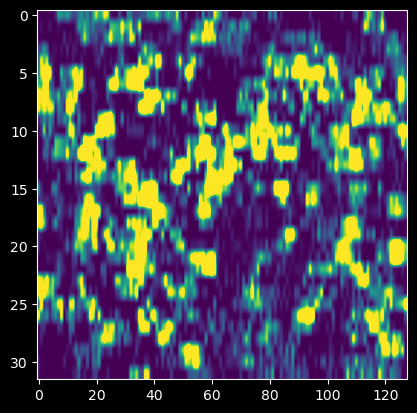

In [27]:
# do reg?
import os
from util import register

importlib.reload(register)

reg = register.register(
    # os.path.join(bin_path, 'p1141_p1632_00009_anatomy.bin'),
    raw_file,
    stack,
    os.path.join(bin_path, raw_file_root),
    e.props,
)



In [2]:
mask_file = r"C:\Users\zfj\data\021923B\p1141_p1632_stack_max_cp_masks.png"

import numpy as np
from PIL import Image
mask = np.asarray(Image.open(mask_file).getdata()).reshape((512,512))
# np_frame = np.array(im_frame.getdata())

# mask = suite2p.io.tiff.open_tiff(mask_file, True)[0].pages[0].asarray()

In [9]:
i = Image.open(mask_file)
i.size
# np.asarray(i.getdata()).shape

(512, 512)

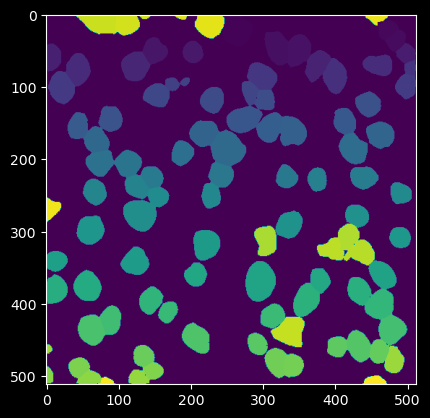

In [104]:
plt.imshow(mask)

In [61]:
spots
# ffunc.shape

,pre_on,stim_on,stim_off,tail_off,pre_on_i,stim_on_i,stim_off_i,tail_off_i,epoch_id,cx,cy
0,5559360,5593056,5626749,5727698,3,15,29,74,309,12.362765,5.116065
1,5734395,5761394,5795075,5896036,78,90,104,149,309,-28.090029,-16.571284
2,5902714,5929725,5963413,6064375,153,165,179,224,309,-13.384621,15.076024
3,6071050,6098055,6131706,6232698,228,240,254,299,309,-27.229717,-14.694293
4,6239389,6266394,6299962,6401036,303,315,329,374,309,-24.172093,0.357423
...,...,...,...,...,...,...,...,...,...,...,...
23,142371585,142398463,142432159,142533114,1728,1740,1754,1799,331,15.486746,14.438884
24,142539924,142566802,142600498,142701444,1803,1815,1829,1874,331,22.266667,14.621300
25,142708264,142735141,142768838,142869783,1878,1890,1904,1949,331,-8.953395,-23.644775
26,142876603,142903480,142937177,143038123,1953,1965,1979,2024,331,11.132143,10.893626


In [105]:
dark_file = r"C:\Users\zfj\data\120822B\darkness_00003.tif"

importlib.reload(preprocess)

if len(spots):

    si = spots.copy()
    si.index = si.index + si.epoch_id*28 #nspotsperepoch
    spots_df = preprocess.segment(os.path.join(bin_path, raw_file_root), e.props, si, mask, dark_file, func_channel = 1, data = ffunc)
    spots_df.join(si[['cx','cy']], on='trial').to_parquet(os.path.join(bin_path, raw_file_root, 'spots.parquet'))

if len(chirps):
    chirps_df = preprocess.segment(os.path.join(bin_path, raw_file_root), e.props, chirps.set_index('epoch_id'), mask, dark_file, func_channel = 1, data = ffunc)
    chirps_df.to_parquet(os.path.join(bin_path, raw_file_root, 'chirps.parquet'))

if len(bars):
    bi = bars.copy()
    bi.index = bi.index + bi.epoch_id*10 #nbarsperepoch
    bars_df = preprocess.segment(os.path.join(bin_path, raw_file_root), e.props, bi, mask, dark_file, func_channel = 1, data = ffunc)
    bars_df.join(bi[['theta']], on='trial').to_parquet(os.path.join(bin_path, raw_file_root, 'bars.parquet'))

# save the dfs...


In [80]:
# spots_df.join(si[['cx','cy']], on='trial').to_parquet(os.path.join(bin_path, raw_file_root, 'spots.parquet'))

C:\Users\zfj\AppData\Local\Temp\ipykernel_18936\3946307766.py:8: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  spl = spline(dfii.trial_t[:,None], dfii.fluor[:,None], smoothing=0.05)


(-100.0, 4000.0)

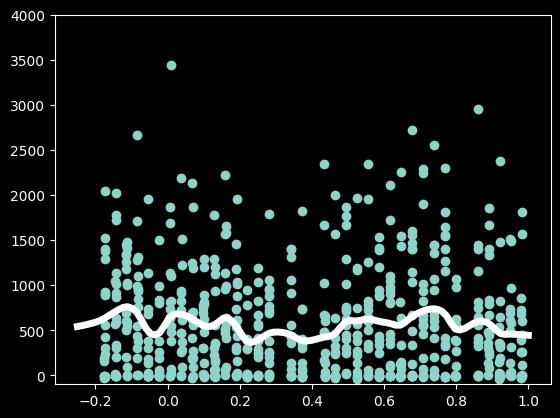

In [311]:
plt.scatter(dfii.trial_t, dfii.fluor)

from scipy.interpolate import RBFInterpolator as spline

xn = np.linspace(-.25,1.0,100)[:,None]


spl = spline(dfii.trial_t[:,None], dfii.fluor[:,None], smoothing=0.05)
plt.plot(xn, spl(xn), 'w', linewidth=5)
plt.ylim(-100,4000)

In [330]:
dfii

,fluor,trial_t,x,y,col,line,frame,trial,roi,baseline_fluor,dFoF,cx,cy
t,,,,,,,,,,,,,
288.46382700000004,-12.694736,-0.088474,339.899994,469.600006,86.0,31.0,9484.0,2873.0,80.0,0.0,0.0,15.473049,29.249255


Index(['fluor', 'trial_t', 'x', 'y', 'col', 'line', 'frame', 'trial', 'roi',
       'baseline_fluor', 'dFoF', 'cx', 'cy'],
      dtype='object')


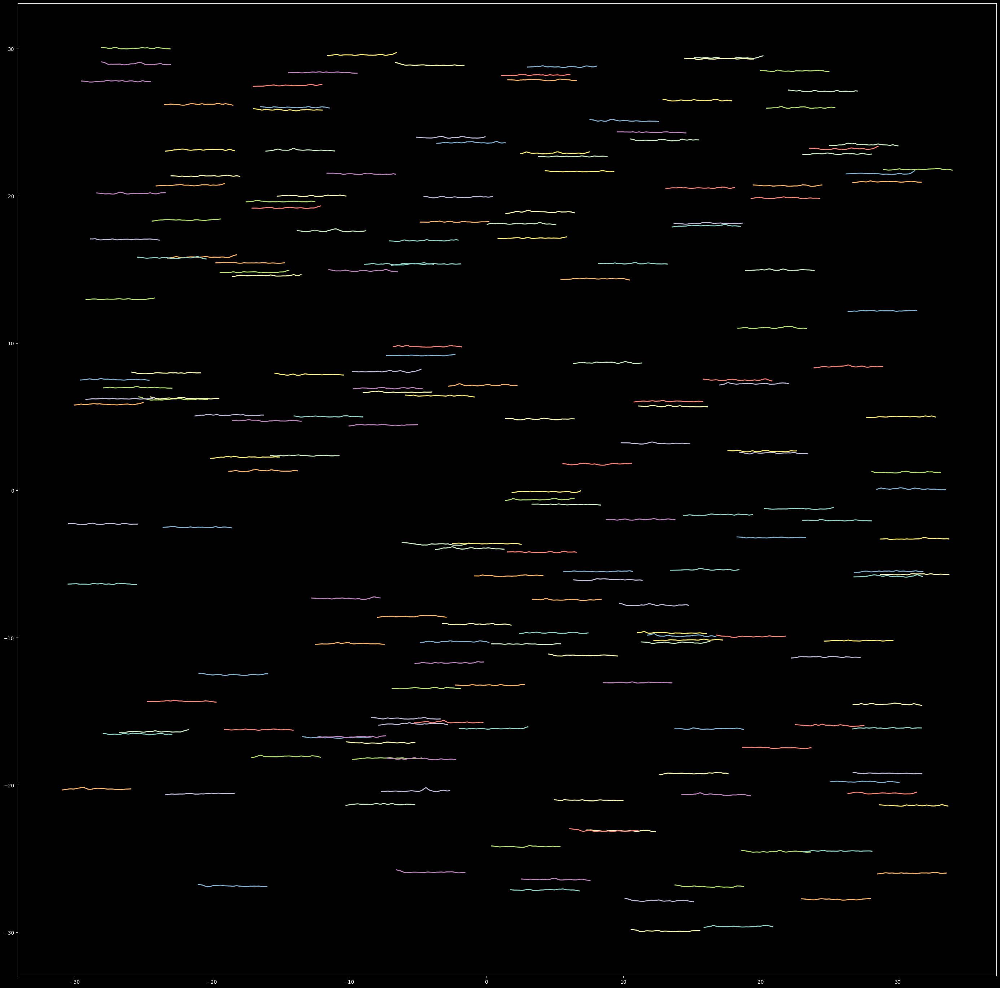

In [332]:
# roi=10

# from scipy.stats import norm
# k = norm().pdf(np.linspace(-3,3,50))
# k /= k.sum()
# k = 1



# from scipy.interpolate import UnivariateSpline

xn = np.linspace(-.25,1.0,100)[:,None]

print(dfi.columns)
# k = np.ones(50)/50    

plt.figure(figsize=(35,35))
for roi in range(1,100):
    dfi = df[df.roi == roi].dropna(subset=['fluor','trial_t']).join(si[['cx','cy']], on='trial')

    plt.cla()
    for trial in np.unique(dfi.trial):
        dfii = dfi[dfi.trial == trial].sort_values('trial_t')
        if len(dfii)<3:
            continue
        # print(dfii.iloc[0].x, dfii.iloc[0].y)
        # plt.plot(dfii.trial_t*4 + dfii.iloc[0].cx, np.convolve(dfii.fluor, k, mode='same')/200  + dfii.iloc[0].cy, linewidth=1)
        # plt.plot(dfii.trial_t, np.convolve(dfii.fluor, k, mode='same')/200, linewidth=0.5)

        spl = spline(dfii.trial_t.to_numpy()[:,None], dfii.fluor.to_numpy()[:,None], smoothing=0.05)

        plt.plot(xn*4 + dfii.iloc[0].cx, spl(xn)/1000  + dfii.iloc[0].cy, linewidth=2)

    plt.savefig(f"C:\\Users\\zfj\\data\\021923B\\func\\p1141_p1632_00004\\spots\\{roi}.png")
    

# print(dfii)

In [188]:
# dfi = df[(df.roi==16)].dropna(subset=['fluor','trial_t'])
# r = dfi.join(bars, on='trial').groupby('theta')['fluor'].apply(np.mean)
# r    
    
np.linspace(0,2*np.pi,11)[:10]

array([0.        , 0.62831853, 1.25663706, 1.88495559, 2.51327412,
       3.14159265, 3.76991118, 4.39822972, 5.02654825, 5.65486678])

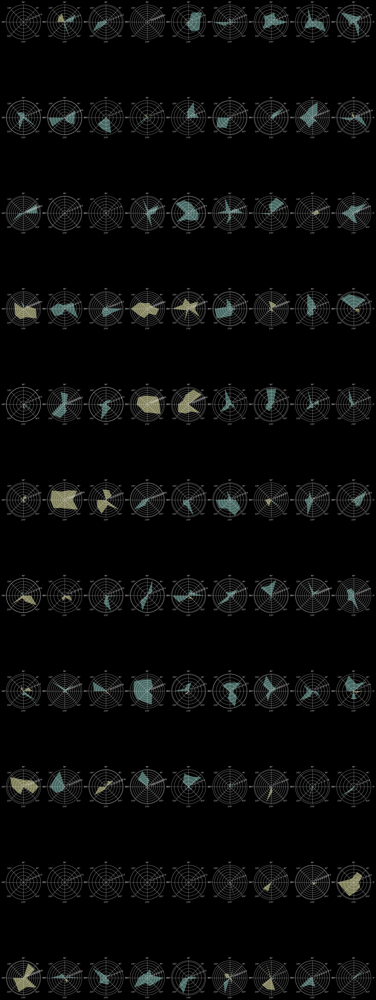

In [189]:
# for i in range(10):
    # dfi = df[(df.roi==16) & (df.trial==i)].dropna(subset=['fluor','trial_t'])
    # plt.plot(dfi.trial_t, dfi.fluor)
    # plt.plot(dfi.trial_t, np.convolve(dfi.fluor, k, mode='same') + 0*i)
# dfi = df[(df.roi==16) ].dropna(subset=['fluor','trial_t'])
# dfi.groupby(by='theta')
# dfi

# bars.join(dfi, on='trial')
fig, ax = plt.subplots(11,9,figsize=(35,100),subplot_kw={'projection': 'polar'})
ax = ax.flatten()
# fig, ax = plt.subplots(1,1,subplot_kw={'projection': 'polar'})


for i in range(99):
# i = 16
    dfi = df[(df.roi==i) & (df.trial_t>0)].dropna(subset=['fluor','trial_t'])
    r = dfi.join(bars, on='trial').groupby('theta')['fluor'].apply(np.mean)

    dfi = df[(df.roi==i) & (df.trial_t<=0)].dropna(subset=['fluor','trial_t'])
    bl = dfi.join(bars, on='trial').groupby('theta')['fluor'].apply(np.mean)

    ron = (r - bl)/bl
    ron[ron<0] = 0

    if len(ron) != 10:
        continue
    ax[i].fill(np.linspace(0,2*np.pi,11)[:10], ron, alpha=.5)

    roff = (bl - r)/bl
    roff[roff<0] = 0
    ax[i].fill(np.linspace(0,2*np.pi,11)[:10], roff, alpha=.5)




# plt.plot(np.linspace(0,2*np.pi,10), r)
# plt.fill_between(np.linspace(0,2*np.pi,10), r)


In [363]:
len(dfi)

0

In [364]:
xn = np.linspace(-2,33.0,200)[:,None]


plt.figure(figsize=(35,250))
k = np.ones(100)/100    
for i in range(1,int(df.roi.max())):
    dfi = df[df.roi == i].dropna(subset=['fluor','trial_t'])
    
    if not len(dfi):
        continue
    
    spl = spline(dfi.trial_t.to_numpy()[:,None], dfi.fluor.to_numpy()[:,None], smoothing=0.05)

    plt.plot(xn, spl(xn) + 1000*i)


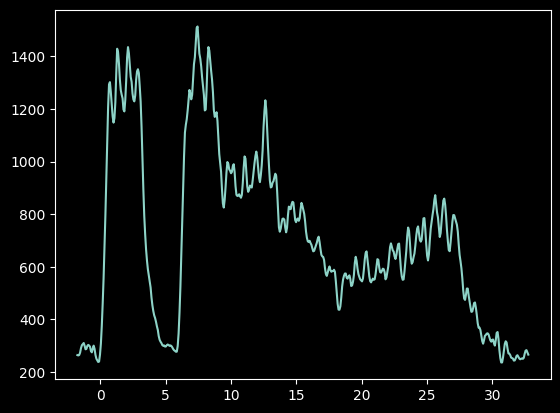

In [441]:
xn = np.linspace(-1.75,32.75,500)

from scipy.interpolate import CubicSpline, RBFInterpolator
# spline = lambda x,y,xi: np.interp(xi, x, y)
# spline = lambda x,y,xi: CubicSpline(x,y)(xi)
spline = lambda x,y,xi: RBFInterpolator(x.to_numpy()[:,None], y.to_numpy()[:,None], smoothing=0.5)(xi[:,None])
# k = np.ones(25)/25

# from scipy.stats import norm
# k = norm().pdf(np.linspace(-3,3,15))
# k /= k.sum()

# spline = lambda x,y,xi: np.interp(xi, x, np.convolve(y, k, mode='same'))


# k = np.ones(100)/100    
# for i in range(9,10):
roi = 9

dfi = df[df.roi == roi].dropna(subset=['fluor','trial_t']).sort_values('trial_t')

# print(dfi.groupby('frame').mean())
# dfi = dfi.groupby('frame').mean()

dfi = dfi.groupby(['frame','line']).mean()

# print(dfi)

# if not len(dfi):
    # continue
# 
# spl = spline(dfi.trial_t, dfi.fluor, )#, smoothing=0.1)

plt.plot(xn, spline(dfi.trial_t, dfi.fluor,xn))

# print(dfi)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


394 3934
245.42662 252.81076


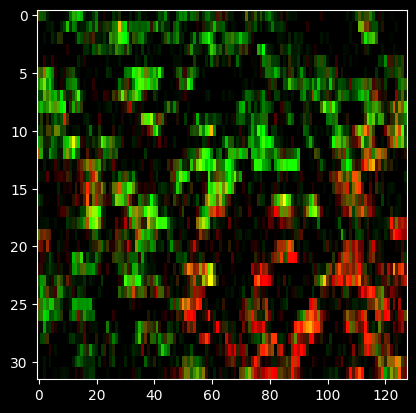

In [90]:
# yi,xi = 16,85

# mini = np.argmin(sx[:,yi,xi])
# maxi = np.argmax(sx[:,yi,xi])

mini = np.argmin(sx.mean(axis=(1,2)))
maxi = np.argmax(sx.mean(axis=(1,2)))


print(mini,maxi)

print(sx[mini].mean(),sx[maxi].mean())

# # sx.shape, sx.flat[np.argmax(sx)], sx.flat[np.argmin(sx)]
# print(np.argmax(sx)//(32*128), np.argmin(sx)//(32*128))


# _,axs = plt.subplots(1,2,figsize=(15,7))
# axs[0].imshow(ianat[3934], aspect=4, interpolation='none')
# axs[1].imshow(ianat[2069], aspect=4, interpolation='none')
plt.imshow(
    np.stack((ianat[mini]/4000,ianat[maxi]/10000,np.zeros((32,128))),axis=-1),
    aspect=4,interpolation='none'
    )

# # plt.imshow(sx[0], aspect=4,interpolation='none')
# # plt.colorbar()

In [337]:
# ffunc
# fi = 47
# plt.imshow(ffunc[tmp.iloc[0].flips[0] // (32*128) + fi], aspect=4, interpolation='none')
d = ifunc[tmp.iloc[0].flips[0] // (32*128) : tmp.iloc[0].flips[-1] // (32*128)].copy()

# plt.plot(np.nanmean(d[:,15:17,30:40], axis=(1,2)))

# from sklearn.decomposition import PCA #MiniBatchSparsePCA as PCA # SparsePCA as PCA
# from sklearn.decomposition import MiniBatchSparsePCA as PCA # SparsePCA as PCA
from sklearn.decomposition import SparsePCA as PCA


d = d.reshape((-1, 32*128))
d = d - d.mean(axis=0)
d = d / d.std(axis=0)


# pca = PCA(n_components=100)#, n_jobs=8, alpha=5, batch_size=20)
# pca = PCA(n_components=100, n_jobs=8, alpha=6, batch_size=20)
pca = PCA(n_components=100, n_jobs=8, alpha=6,)
pcs = pca.fit_transform(d.T)
print(pcs.shape, pca.components_.shape)


(4096, 100) (100, 1150)


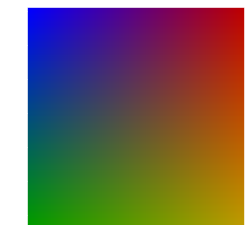

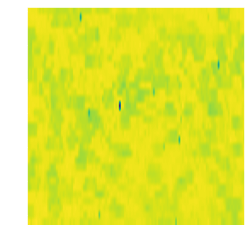

In [315]:
r = np.tile(np.linspace(0,0.75,128)[None,:],( 32,1)).flatten()
g = np.tile(np.linspace(0,0.6, 32)[:,None],(1,128)).flatten()
b = (np.flip(np.linspace(0,1.0,32))[:,None] * np.flip(np.linspace(0,1.0,128))[None,:]).flatten()

c = np.stack((r,g,b), axis=1)

plt.imshow(c.reshape((32,128,3)), aspect=4)
plt.show()

plt.imshow(d.reshape((-1,32,128)).min(axis=0), aspect=4)

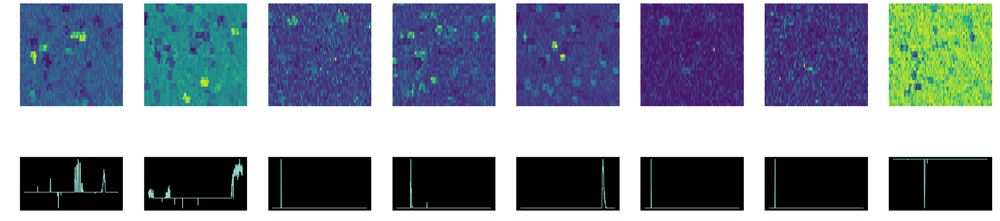

In [338]:
_,axs = plt.subplots(2,8,figsize=(40,10), gridspec_kw={'height_ratios':[3,1]})

for cmp in range(8):
    # if pcs[np.argmax(np.abs(pcs[:,cmp])),cmp] < 0:
    #     sign = -1
    # else:
    #     sign = 1

    # axs[0,cmp].imshow(sign * pca.components_[cmp].reshape(32,128), aspect=4, interpolation = 'none')
    # axs[1,cmp].plot(sign * pcs[:,cmp])
    axs[0,cmp].imshow(pcs[:,cmp].reshape(32,128), aspect=4, interpolation = 'none')
    axs[1,cmp].plot(pca.components_[cmp,:])
    


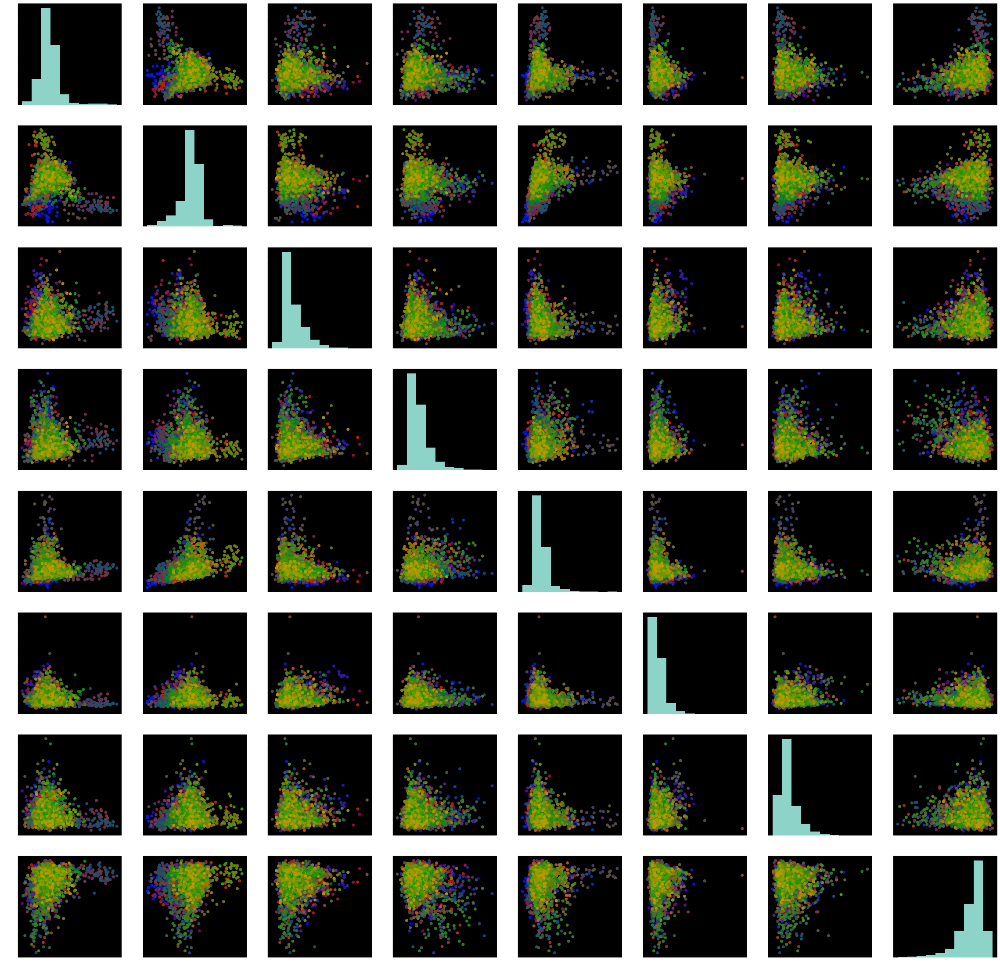

In [341]:
_,axs = plt.subplots(8,8,figsize=(40,40),)# gridspec_kw={'height_ratios':[3,1]})

for i in range(8):
    for j in range(8):
        if i == j:
            # axs[i,j].hist(pca.components_[i])
            axs[i,j].hist(pcs[:,i])
        else:
            # axs[i,j].scatter(pca.components_[i], pca.components_[j], c = c)
            axs[i,j].scatter(pcs[:,j], pcs[:,i], c = c)

    # if pcs[np.argmax(np.abs(pcs[:,cmp])),cmp] < 0:
    #     sign = -1
    # else:
    #     sign = 1

    # axs[0,cmp].imshow(sign * pca.components_[cmp].reshape(32,128), aspect=4, interpolation = 'none')
    # axs[1,cmp].plot(sign * pcs[:,cmp])



(4096, 2)


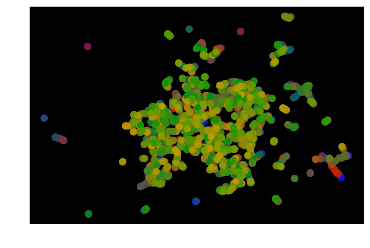

In [306]:
import umap
mod = umap.UMAP(n_neighbors=3, min_dist=.0001)
#emb = mod.fit_transform(d.T)#
emb = mod.fit_transform(pca.components_[:10,:].T)
print(emb.shape)
plt.scatter(emb[:,0], emb[:,1], c=c)

C:\Users\zfj\AppData\Local\Temp\ipykernel_45444\1307296707.py:7: RuntimeWarning: Mean of empty slice
  im = axs[0].imshow(np.nanmean(spat, axis=1), aspect=1/4, interpolation='none')
C:\Users\zfj\AppData\Local\Temp\ipykernel_45444\1307296707.py:13: RuntimeWarning: Mean of empty slice
  im2 = axs[1].imshow(np.nanmean(spat2, axis=1), aspect=1/4, interpolation='none')


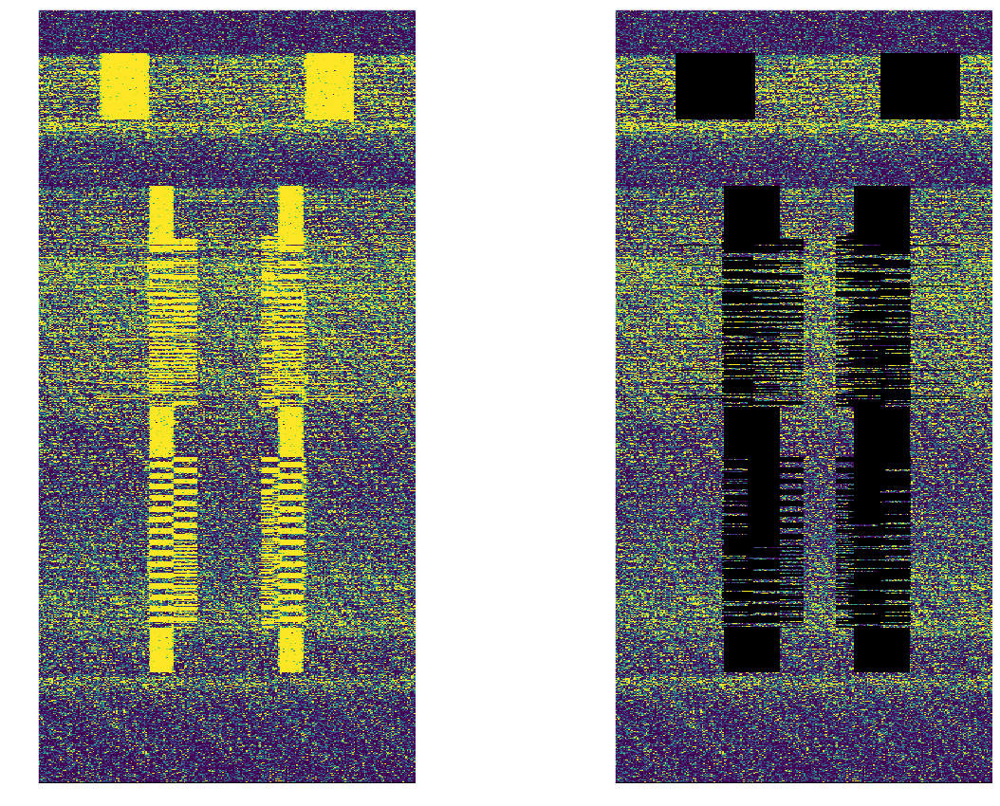

In [167]:
# plt.plot(pat)
# plt.show()

# plt.plot(spat.mean(axis=1))
# plt.plot(np.nanmean(spat,axis=1))
_,axs = plt.subplots(1,2,figsize=(20,15))
im = axs[0].imshow(np.nanmean(spat, axis=1),   aspect=1/4, interpolation='none')
# im = axs[0].imshow(spat[:,1,:], aspect=1/4, interpolation='none')
im.set_clim(0,100)


# im2 = axs[1].imshow(spat2[:,1,:], aspect=1/4, interpolation='none')
im2 = axs[1].imshow(np.nanmean(spat2, axis=1), aspect=1/4, interpolation='none')
im2.set_clim(0,100)
# plt.colorbar()
# plt.clim(0,100)

In [33]:
np.round(.125 * 255).astype(np.uint8)

32

In [36]:
anat = tif.data().reshape((-1,4,32,128))[:,0,:,:].flatten().copy()
mask = np.zeros_like(anat, dtype=bool)
lookup = np.load('artifact_lut.npy')

# flips = tmp.flips.to_numpy()[0]
# for i in range(1, len(flips)):
#     tx = tt[flips[i-1]:flips[i]]

#     ti = ((tx - tx[0])/(tx[-1]-tx[0]) * 255).astype(int)
    
#     fx = anat[flips[i-1]:flips[i]]

#     #instead, we need the frame index to figure out what the mask should be for a given frame
#     mask[flips[i-1]:flips[i]] = np.logical_and(ti>=72, ti<197)

for row, chirp in chirps.join(e.epochs[e.epochs.trial_type == b'chirp'], on='epoch_id').iterrows():
    #for now, we know the intensity is 0.125 == 1/8 aka 32 aka 00100000
    pattern = chirp_pattern(chirp.chirpIntensity, chirp.frameRate) #TODO: i want this to just be chirp.intensity...

    #this is all sorts of wrong
    # the main thing is that we need to interp the times, not the pixel indices
    for i,(a,b) in enumerate(intervals(chirp.flips)):
        if (a < chirp.stim_on) or (a >= chirp.stim_off):
            mask[a:b] = True
        else:
            frame_mask = lookup[pattern[i]]
            frame_subind = (np.arange(b-a)/(b-a)*255).astype(np.uint8) #now these range from 0 to 255
            mask[a:b] = frame_mask[frame_subind]

#at the end, we need to make sure to flip the mask so that it looks like the image...
mask = mask.reshape((-1,32,128))
mask[:,1::2,:] = np.flip(mask[:,1::2,:], axis=2)
mask = mask.flatten()


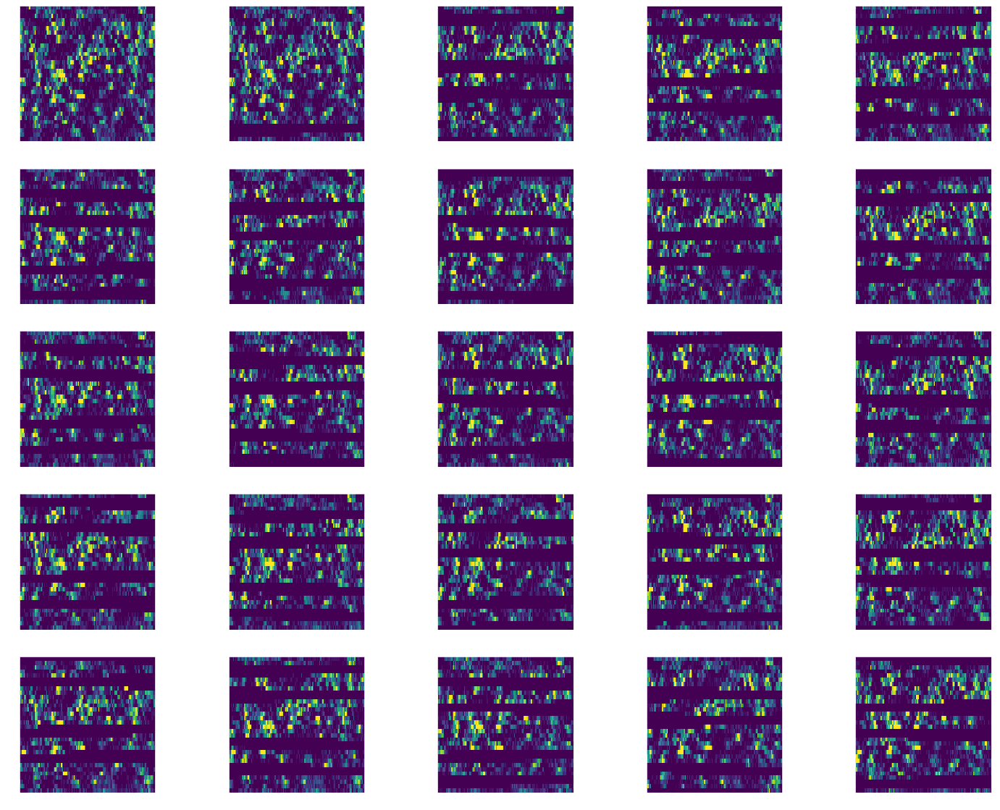

<Figure size 432x288 with 0 Axes>

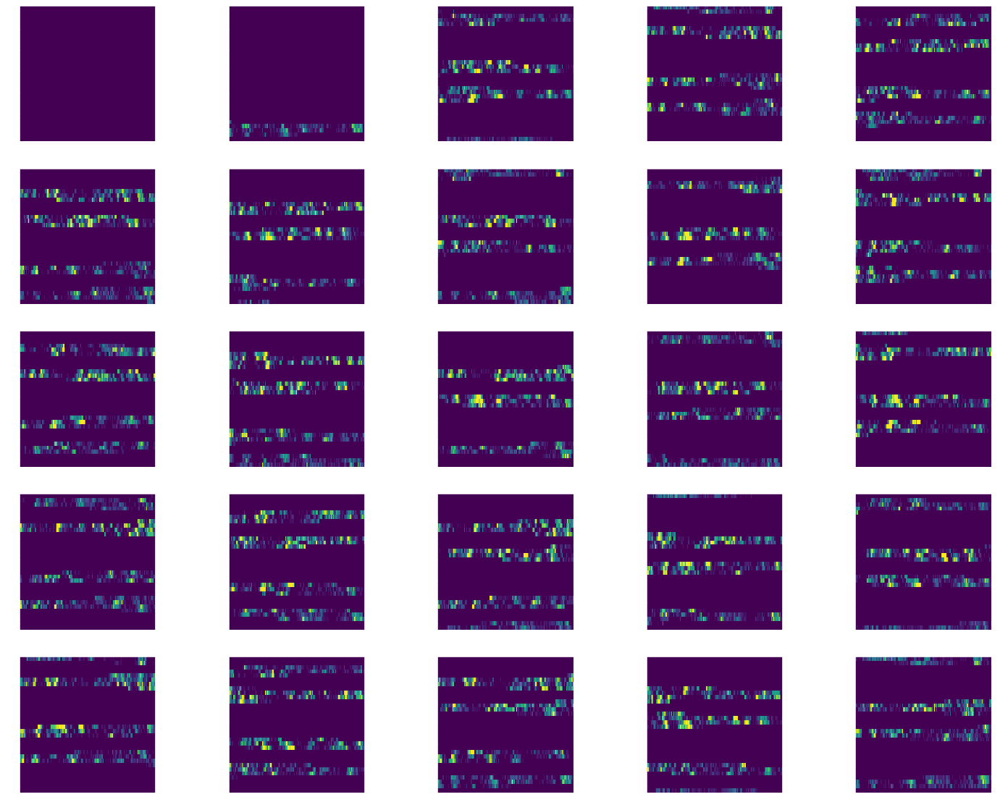

In [37]:
# plt.imshow(func[chirps.stim_on.to_numpy()[0] // (32*128) + 1], aspect=4, interpolation='none')
# plt.clim(0,1000)
# plt.colorbar()
# plt.show()

_,axs = plt.subplots(5,5,figsize=(25,20))
for i,ax in enumerate(axs.flat):
    ind = chirps.stim_on.to_numpy()[0] // (32*128) + i
    im = ax.imshow(
        anat.reshape((-1,32,128))[ind] * mask.reshape(-1,32,128)[ind]        
        , aspect=4, interpolation='none')
    im.set_clim(0,10000)

plt.figure()

_,axs = plt.subplots(5,5,figsize=(25,20))
for i,ax in enumerate(axs.flat):
    ind = chirps.stim_on.to_numpy()[0] // (32*128) + i
    im = ax.imshow(
        anat.reshape((-1,32,128))[ind] * (~mask.reshape(-1,32,128)[ind])    
        , aspect=4, interpolation='none')
    im.set_clim(0,10000)
# plt.colorbar()
# plt.show()

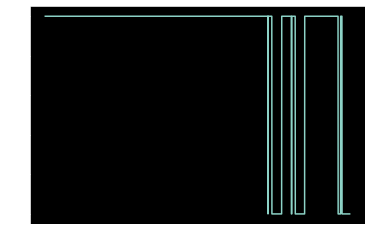

In [38]:
plt.plot(mask[chirps.stim_on.to_numpy()[0] :][:10000])

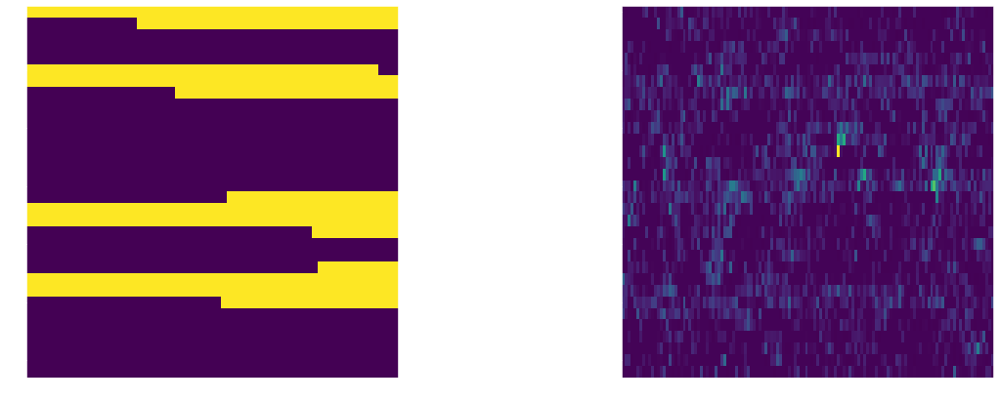

In [39]:
_,axs = plt.subplots(1,2, figsize=(20,7))

ax = axs[0]
ind = (chirps.stim_on.to_numpy()[0] // (32*128)) + 3
im = ax.imshow(
    ~mask.reshape(-1,32,128)[ind]   
    , aspect=4, interpolation='none')
# im.set_clim(0,10000)

ax = axs[1]
im = ax.imshow(
    func.reshape(-1,32,128)[ind]   
    , aspect=4, interpolation='none')


In [40]:
sl = anat.reshape((-1,32,128))[chirps.stim_on.to_numpy()[0] // (32*128): chirps.stim_on.to_numpy()[0] // (32*128)+33]
bl = mask.reshape((-1,32,128))[chirps.stim_on.to_numpy()[0] // (32*128): chirps.stim_on.to_numpy()[0] // (32*128)+33]

t = sl[:,16,64].copy()


print(bl.shape, sl.shape)
#bl is true where we want to interp

from scipy.interpolate import interp1d
t[np.argwhere(~bl[:,16,64]).flatten()] = interp1d(np.argwhere(bl[:,16,64]).flatten(), sl[:,16,64][bl[:,16,64]], fill_value='extrapolate')(np.argwhere(~bl[:,16,64]).flatten())

(33, 32, 128) (33, 32, 128)


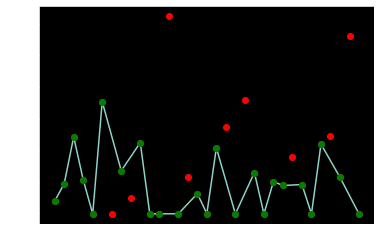

In [41]:
plt.plot(t) #the interpolated version
plt.plot(sl[:,16,64],'ro') # the original poinsts
plt.plot(np.argwhere(bl[:,16,64]), sl[:,16,64][bl[:,16,64]], 'go') #the remaining points


In [42]:
sl = func.reshape((-1,32,128))[chirps.stim_on.to_numpy()[0] // (32*128): chirps.stim_on.to_numpy()[0] // (32*128)+1000]
bl = mask.reshape((-1,32,128))[chirps.stim_on.to_numpy()[0] // (32*128): chirps.stim_on.to_numpy()[0] // (32*128)+1000]

t = sl.copy()
for i in range(32):
    for j in range(128):
        k = np.nonzero(~bl[:,i,j].flatten())[0] #points to interpolate
        l = np.nonzero(bl[:,i,j].flatten())[0] #points to keep

        t[k,i,j] = interp1d(l, sl[l,i,j], fill_value='extrapolate')(k)

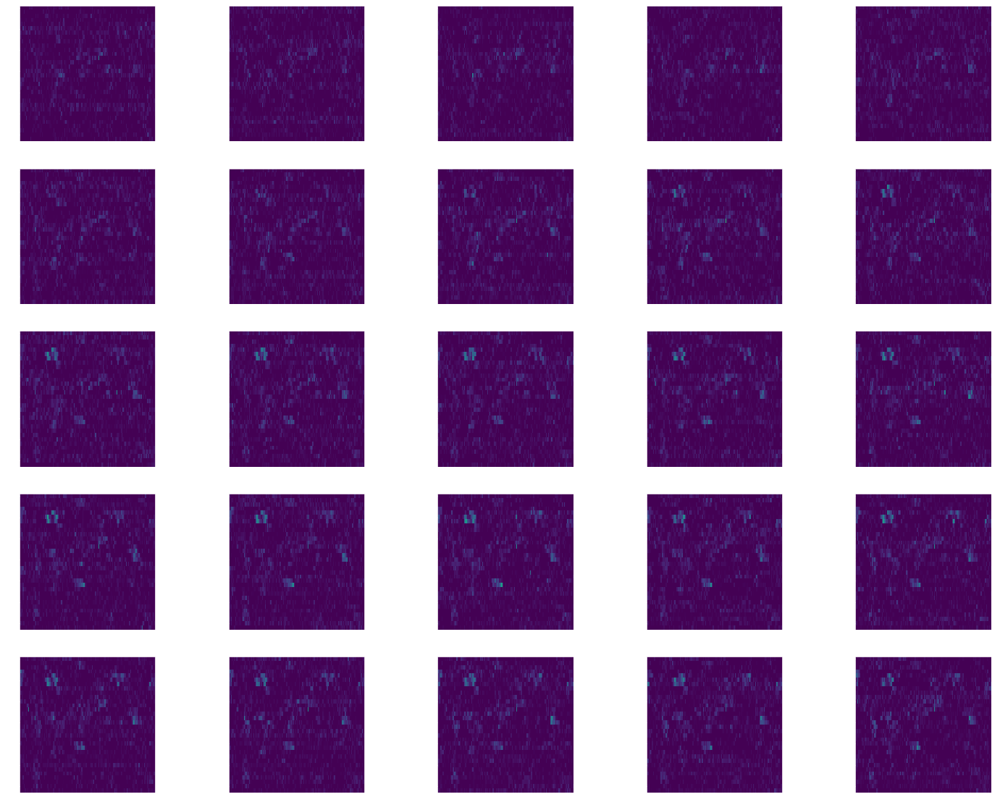

In [43]:
_,axs = plt.subplots(5,5,figsize=(25,20))
for i,ax in enumerate(axs.flat):
    im = ax.imshow(t[i], aspect=4, interpolation='none')
    # im = ax.imshow(t[i] - sl[i], aspect=4, interpolation='none')
    
    im.set_clim(0,10000)

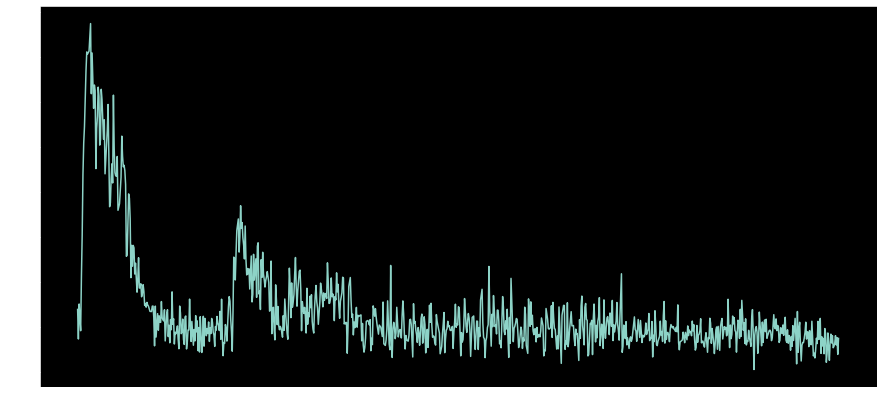

C:\Users\zfj\AppData\Local\Temp\ipykernel_10192\1062912199.py:23: RuntimeWarning: Mean of empty slice
  plt.plot(ti,np.nanmean(tt[:,4:7,25:30], axis=(-2,-1)))


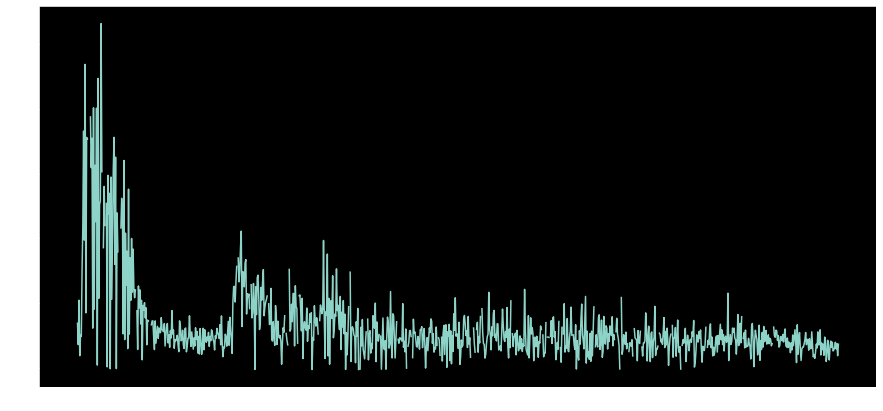

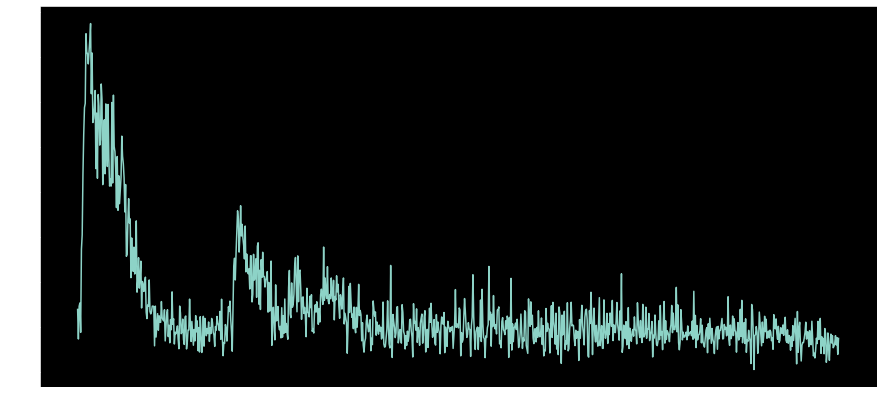

In [44]:
ti = np.arange(1000) / e.props['frame_rate']

plt.figure(figsize=(15,7))
#a few example rois from the test movie


plt.plot(ti,t[:,4:7,25:30].mean(axis=(-2,-1)))
# plt.plot(ti,t[:,10, 31:35].mean(axis=-1))
# plt.plot(ti,t[:,16,:5].mean(axis=-1))
# plt.plot(ti,t[:,23,94:103].mean(axis=-1))
plt.show()
# they look great!

plt.figure(figsize=(15,7))
tt = sl.copy().astype(np.double)
tt[~bl] = np.nan

# plt.plot(ti,np.nanmean(tt[:,10,31:35], axis=-1))
# plt.plot(ti,np.nanmean(tt[:,16,:5], axis=-1))
# plt.plot(ti,np.nanmean(tt[:,23,94:103], axis=-1))


plt.plot(ti,np.nanmean(tt[:,4:7,25:30], axis=(-2,-1)))
# plt.plot(ti,np.nanmean(tt[:,16,:5], axis=-1))
# plt.plot(ti,np.nanmean(tt[:,23,94:103], axis=-1))


plt.figure(figsize=(15,7))
plt.plot(ti,sl[:,4:7,25:30].mean(axis=(-2,-1)))


In [229]:
#For each video
#   For each pixel
#       Calculate whether to mask the pixel based on the intensity
#       Interpolate masked pixels using linear interpolation
#       Run motion detection


# t.reshape((-1,32*128)).shape

# l,v = np.linalg.eig(np.cov(t.reshape((-1,32*128)).T))

from sklearn.decomposition import PCA #MiniBatchSparsePCA as PCA # SparsePCA as PCA

d = t.reshape((-1, 32*128))
d = d - d.mean(axis=0)
d = d / d.std(axis=0)


pca = PCA(n_components=100)#, n_jobs=8, alpha=5, batch_size=20)
pcs = pca.fit_transform(d)


In [230]:
np.count_nonzero([np.count_nonzero(pca.components_[cmp]) for cmp in range(pcs.shape[1])])
print([np.count_nonzero(pca.components_[cmp]) for cmp in range(pcs.shape[1])])



[4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096, 4096]


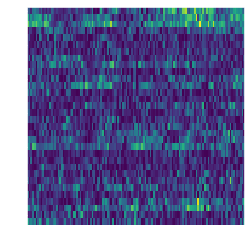

4096


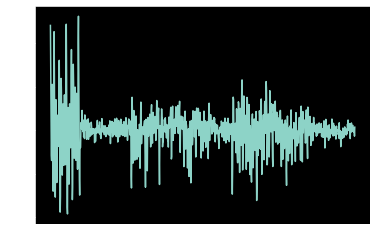

In [241]:
# plt.plot(pcs[:,1])
# pcs.shape
# pca.sco

cmp = 7
if pcs[np.argmax(np.abs(pcs[:,cmp])),cmp] < 0:
    sign = -1
else:
    sign = 1

plt.imshow(np.abs(pca.components_[cmp].reshape(32,128)), aspect=4, interpolation = 'none')
plt.show()
plt.plot(sign * pcs[:,cmp])


print(np.count_nonzero(pca.components_[cmp]))

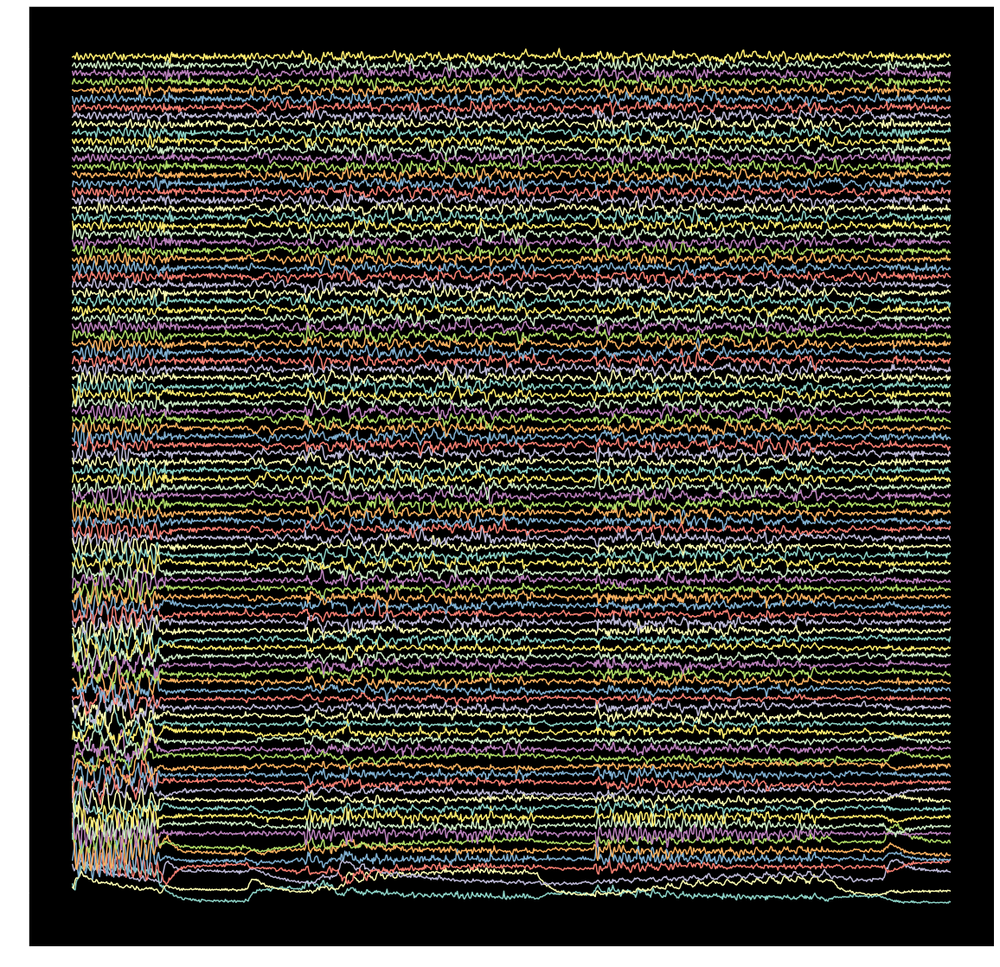

In [232]:
plt.figure(figsize=(20,20))
plt.plot(pcs/10 + np.arange(100).reshape((-1,100)))
plt.show()

(-0.15000000000000002, 3.15, -1.1, 2.1999999999999997)

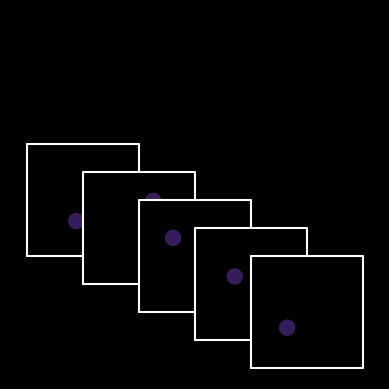

In [61]:
x = np.array([0,1,1,0,0])
y = np.array([0,0,1,1,0])

th = np.linspace(0,2*np.pi,100)
cx = 30/205/2 * np.cos(th)
cy = 30/205/2 * np.sin(th)


for i in range(5):
    plt.fill(x + i/2,y - i/4, 'k', zorder=i)
    plt.plot(x + i/2,y - i/4,'w', zorder=i)
    plt.fill(cx + i/2 + np.random.rand()/2 + .2, cy - i/4 + np.random.rand()/2 + .25, '#4E2A84AF', zorder=i)
plt.axis('square')
plt.axis('off')


